In [361]:
from time import time
import numpy as np
import matplotlib.pyplot as plt
from cycler import cycler
import os

import jax
from jax import Array
import jax.numpy as jnp
import chromatix.functional as cx
from chromatix.ops import init_plane_resample

import optax
from jaxopt.projection import projection_non_negative
from flax import linen as nn
from flax.core import unfreeze, freeze

from skimage.metrics import structural_similarity as ssim

from fun import *   # lazy, bad!!!
from transformations import rotate_volume_4d
from xscatter import get_delta_beta_mix, get_wavenum
from matdecomp import spbi_material_basis
from recon import get_recon



In [242]:
class Material:
    def __init__(self, name, matcomp, density):
        self.name = name
        self.matcomp = matcomp
        self.density = density
    def delta_beta(self, energy):
        delta, beta = get_delta_beta_mix(self.matcomp, np.atleast_1d(energy), self.density)
        return delta.squeeze(), beta.squeeze()

alu = Material('aluminum', 'Al(100.0)', 2.699)
water = Material('water', 'H(11.2)O(88.8)', 1.0)
tissue = Material('tissue', 'H(10.2)C(14.3)N(3.4)O(70.8)Na(0.2)P(0.3)S(0.3)Cl(0.2)K(0.3)', 1.06)
bone = Material('bone', 'H(3.4)C(15.5)N(4.2)O(43.5)Na(0.1)Mg(0.2)P(10.3)S(0.3)Ca(22.5)', 1.92)
fat = Material('adipose', 'H(11.4)C(59.8)N(0.7)O(27.8)Na(0.1)S(0.1)Cl(0.1)', 0.95)
pmma = Material('PMMA', 'H(8.06)C(59.98)O(31.96)', 1.19)


In [352]:
# for later

def TV(img, axes=[0,1,2]):  
    tot_grad = 0
    for axi in axes:
        tot_grad += jnp.sum(jnp.abs(jnp.diff(img, axis=axi)))  
    return tot_grad
    
def L1(img):
    return jnp.abs(img).sum()
    
def rmse(im1, im2):
    return np.sqrt(np.mean((im1-im2)**2))
    
def see_opt(vol_k, truth, loss):
    
    kw = {'vmin':truth.min(), 'vmax':1.1*truth.max(), 'cmap':'viridis'}
    fig, ax = plt.subplots(1,5,figsize=[16,3], dpi=300)
    ax[0].set_title('loss')
    ax[0].plot(loss)
    for i in range(2):
        ax[i+1].set_title(f'mat {i+1} est')
        m = ax[i+1].imshow(vol_k[:,vol_k.shape[1]//2,:,i], **kw)
        fig.colorbar(m, ax=ax[i+1])
        ax[i+3].set_title(f'mat {i+1} truth')
        m = ax[i+3].imshow(truth[:,truth.shape[1]//2,:,i], **kw)
        fig.colorbar(m, ax=ax[i+3])
    for axi in ax[1:]:
        axi.axis('off')
    fig.tight_layout()
    plt.show()

def make_raw_phantom(N, p0=1.0, p1=0.45, p2=0.35, c1=1, c2=1,
                     id0=1, id1=2, id2=3, 
                     DTYPE=np.uint8):
    assert (p1 <= p0/2) and (p2 <= p0/2) and (p1 > 0) and (p2 > 0)
    
    coords = np.linspace(-N/2, N/2, N)
    Z, Y, X = np.meshgrid(coords, coords, coords)
    r1 = p1*N/2
    r2 = p2*N/2
    x1, y1, z1 = -c1*r1/np.sqrt(2), -c1*r1/np.sqrt(2), -r1/2
    x2, y2, z2 = c2*r2/np.sqrt(2), c2*r2/np.sqrt(2), r2/2
    
    obj = np.zeros([N,N,N], dtype=DTYPE)
    obj[np.where(X**2 + Y**2 < (p0*N/2)**2)] = id0
    obj[np.where((X-x1)**2 + (Y-y1)**2 + (Z-z1)**2 < r1**2)] = id1
    obj[np.where((X-x2)**2 + (Y-y2)**2 + (Z-z2)**2 < r2**2)] = id2

    return obj

def make_material_phantom(raw_phantom, mat_dict, energies, jax_array=True):
    Nz, Ny, Nx = raw_phantom.shape
    vol_beta, vol_delta = np.zeros([2, Nz, Ny, Nx, len(energies)])
    for key, mat in mat_dict.items():
        ds, bs = mat.delta_beta(energies)
        for i in range(len(energies)):
            vol_beta[:,:,:,i][np.where(raw_phantom==key)] = bs[i]
            vol_delta[:,:,:,i][np.where(raw_phantom==key)] = ds[i]
    if jax_array:
        vol_beta, vol_delta = jnp.array(vol_beta), jnp.array(vol_delta)
    return vol_beta, vol_delta



# Simulations

Our goal is to perform material decomposition, where we take as input x-ray images (or CT scans) acquired with 2 or more different energies and then solve for "basis material images" (or volumes). In these "BMIs", each pixel (or voxel) represents a projected thickness (or density) of some material of interest. In clinical imaging, this is generally done with a material basis of bone and tissue. In this example, I use aluminum and water. 

There are established analytical methods for performing material decomposition. However, for x-ray images with propagation-based phase contrast, these methods are highly approximate. So I want to use the automatic differentiation capability of chromatix to iteratively solve for the basis material images and hopefully demonstrate better performance relative to the analytical methods.

While I've had success with the forward model and with a simple loss function, my solution below doesn't look very good, and I am unable to `jit`, so it is very slow. 

All distances are in units [m], energies in [keV]. `I0` is the incident beam intensity, which controls the noise level. However, I have commented out the lines to generate noise below, for testing purposes.

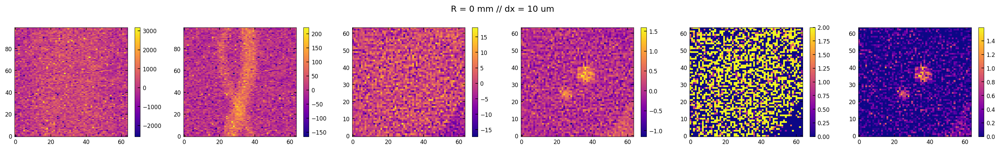

loss @ iter 100: 6.303e-01 (t = 6.5 s)


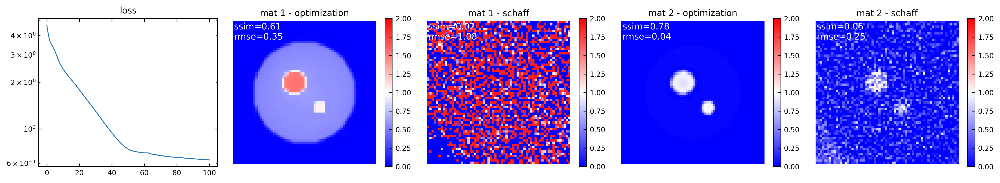

loss @ iter 200: 5.519e-01 (t = 11.6 s)


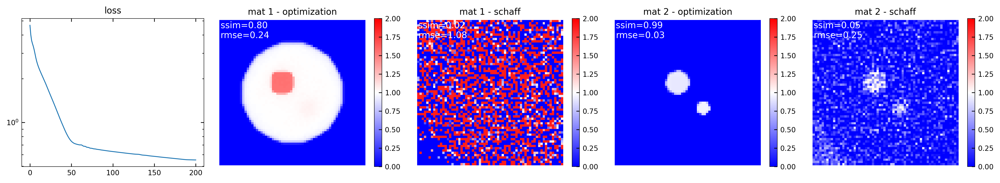

loss @ iter 300: 5.511e-01 (t = 16.6 s)


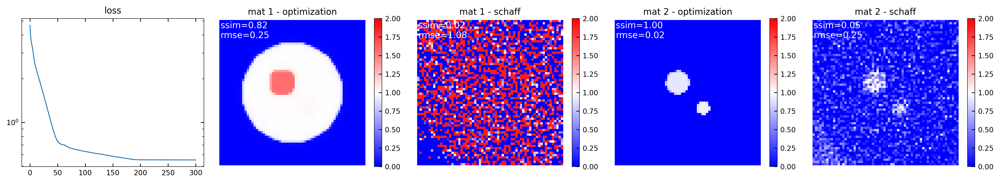

loss @ iter 400: 5.508e-01 (t = 21.7 s)


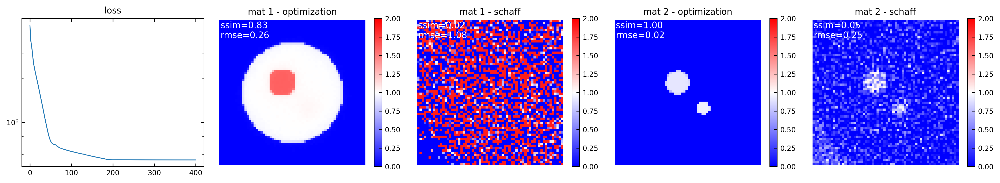

loss @ iter 500: 5.507e-01 (t = 26.8 s)


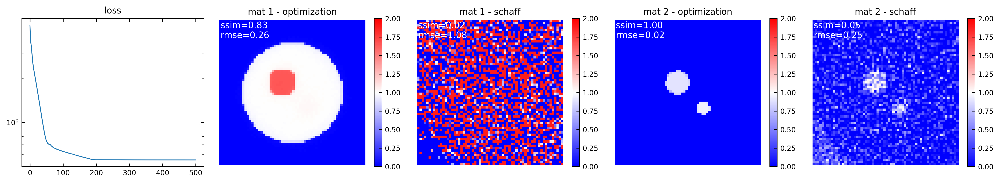

loss @ iter 600: 5.506e-01 (t = 31.9 s)


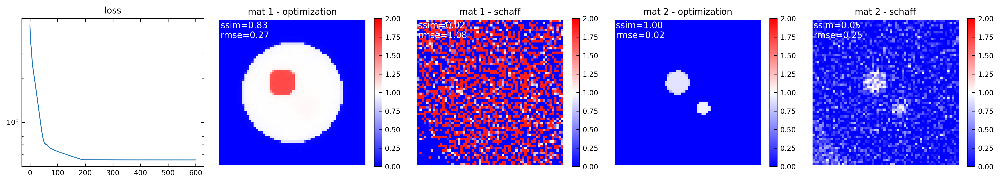

loss @ iter 700: 5.506e-01 (t = 37.0 s)


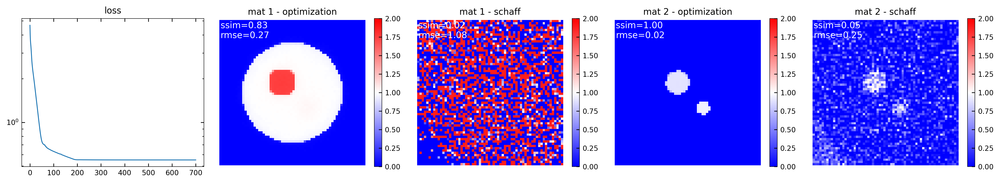

loss @ iter 800: 5.506e-01 (t = 42.2 s)


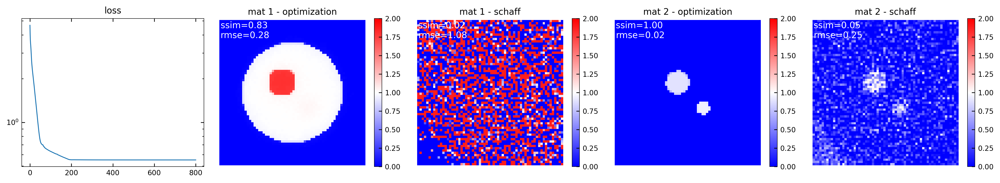

loss @ iter 900: 5.506e-01 (t = 47.3 s)


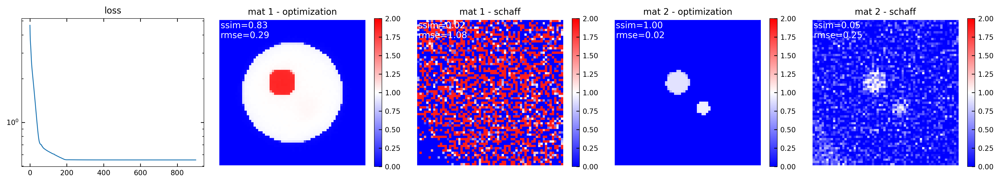

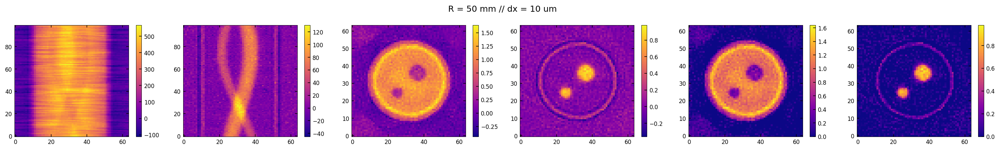

loss @ iter 100: 8.012e-01 (t = 6.5 s)


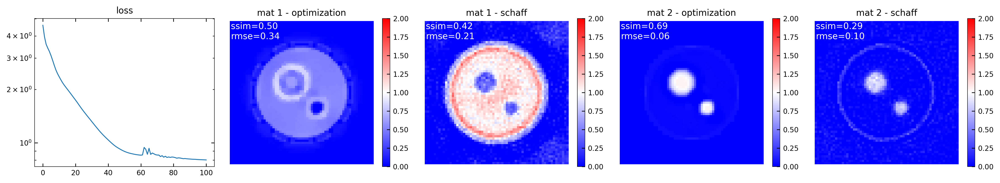

loss @ iter 200: 7.668e-01 (t = 11.6 s)


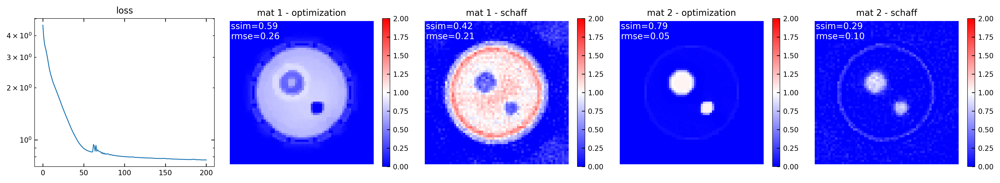

loss @ iter 300: 7.328e-01 (t = 16.8 s)


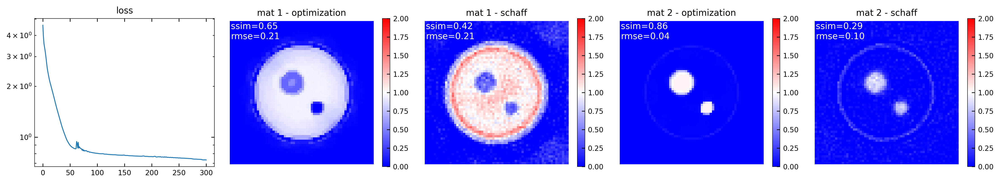

loss @ iter 400: 7.232e-01 (t = 21.9 s)


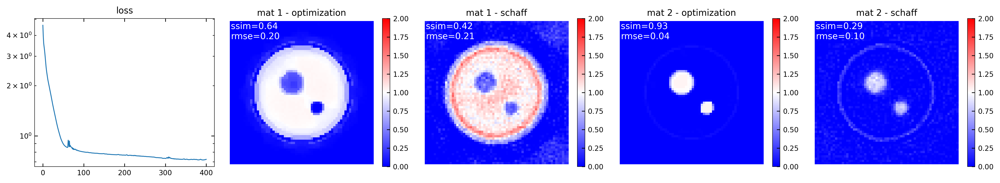

loss @ iter 500: 7.195e-01 (t = 27.0 s)


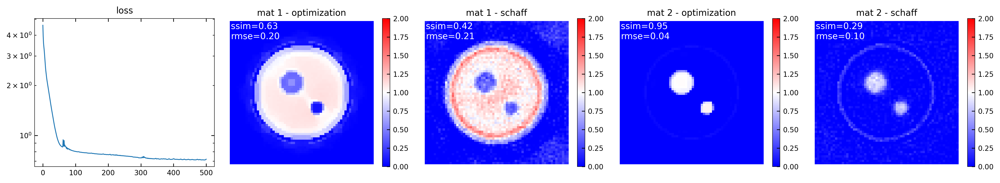

loss @ iter 600: 7.101e-01 (t = 32.1 s)


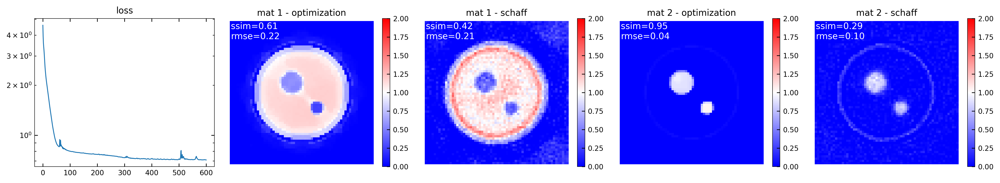

loss @ iter 700: 7.084e-01 (t = 37.2 s)


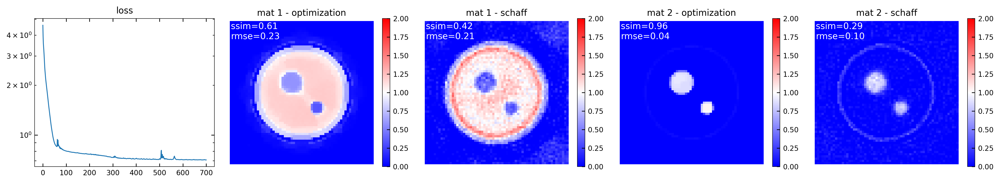

loss @ iter 800: 7.069e-01 (t = 42.4 s)


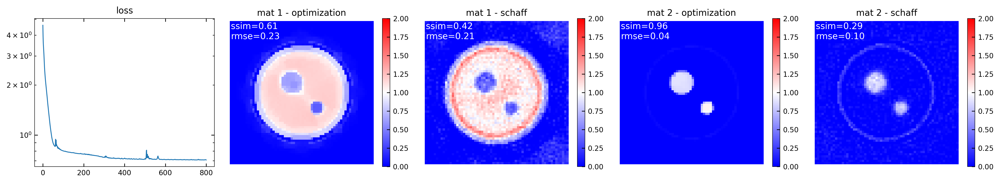

loss @ iter 900: 7.054e-01 (t = 47.5 s)


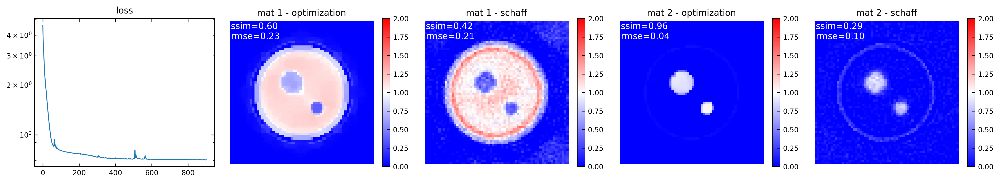

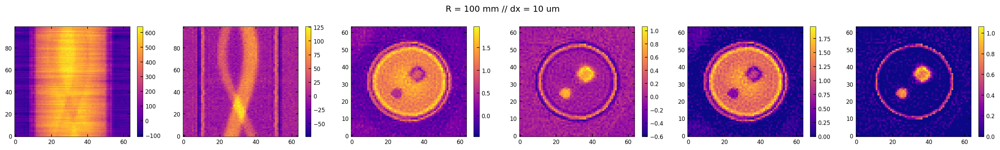

loss @ iter 100: 9.625e-01 (t = 6.4 s)


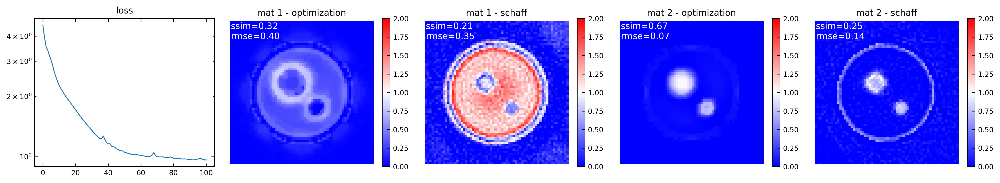

loss @ iter 200: 9.398e-01 (t = 11.5 s)


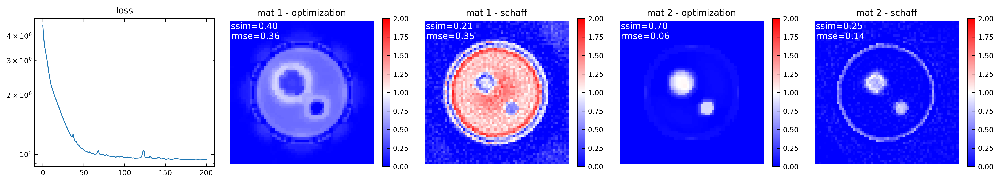

loss @ iter 300: 9.374e-01 (t = 16.5 s)


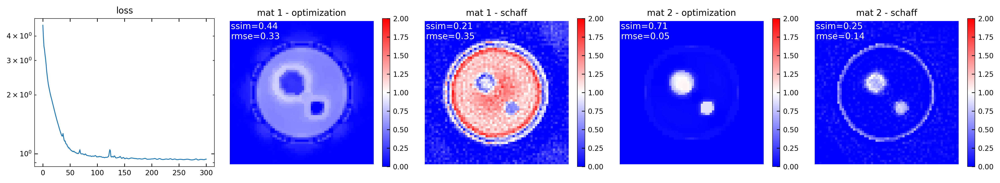

loss @ iter 400: 9.759e-01 (t = 21.6 s)


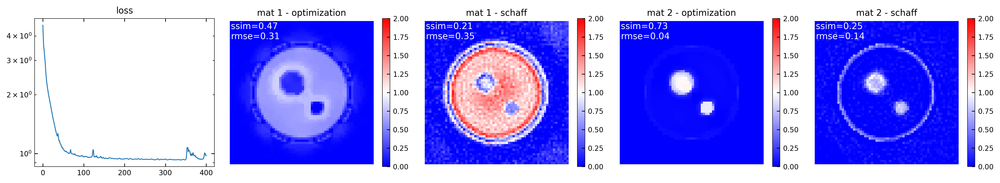

loss @ iter 500: 9.226e-01 (t = 26.6 s)


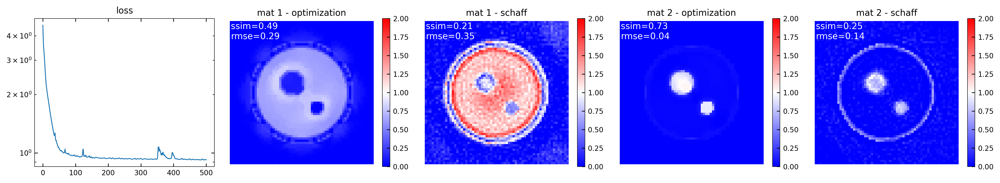

loss @ iter 600: 9.244e-01 (t = 31.7 s)


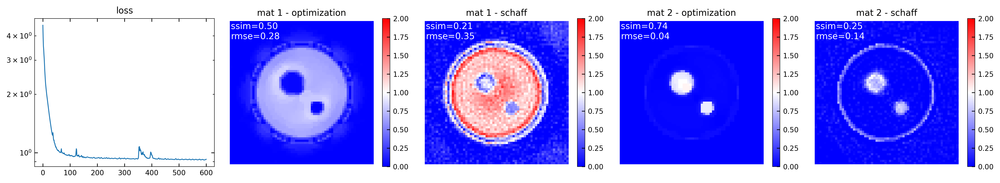

loss @ iter 700: 9.157e-01 (t = 36.8 s)


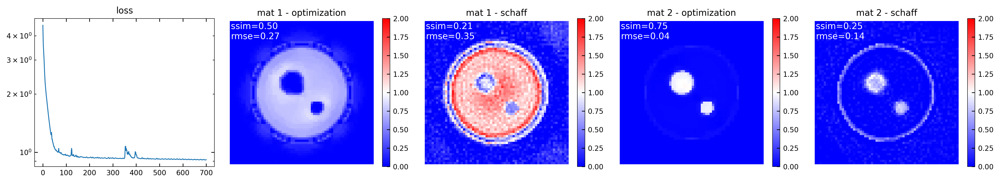

loss @ iter 800: 9.151e-01 (t = 41.8 s)


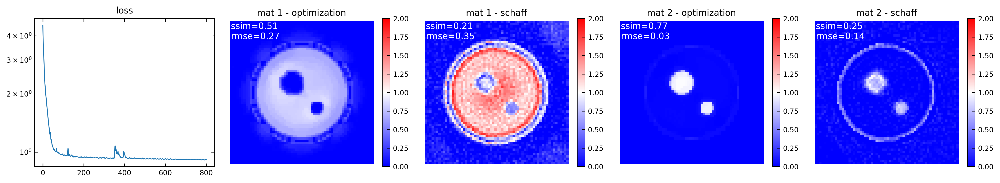

loss @ iter 900: 1.048e+00 (t = 46.9 s)


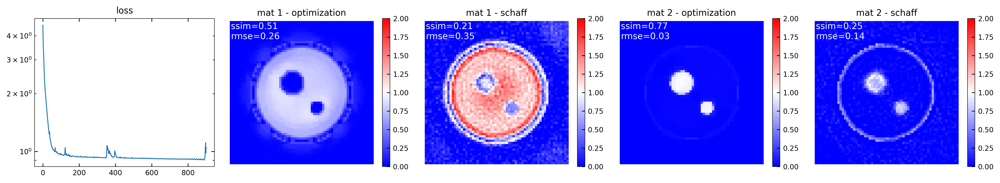

CPU times: user 1min 34s, sys: 20.2 s, total: 1min 54s
Wall time: 2min 43s


In [371]:
%%time
    
for PROPDIST in [0, 50e-3, 100e-3]:
    for NX in [64]: 
        class MultiMatPBI(nn.Module):
        
            # Simulation settings
            propdist = PROPDIST
            energies = jnp.array([24, 34])  
            material_basis = {1:tissue, 2:bone}  #{1: water, 2: alu} 
            # material_basis = {1:pmma, 2:alu}  #{1: water, 2: alu} 
                     
            # Phantom
            phantom_fov: float = 0.625e-3  #0.5e-3
            phantom_dx: float = phantom_fov / NX
            phantom_Nx: int = NX
            phantom_Ny: int = 20
        
            # Detector
            det_Nx: int = phantom_Nx   # for now, set the same.
            det_Ny: int = phantom_Ny
            det_fwhm: float = 10e-6
            det_psf: str = 'lorentzian'  # code for the PSF is in fun.py
            resampling_method: str = 'linear'
            I0: int = 1e11 / (phantom_Nx**2) # should normalize this to pixel size later
        
            # Misc.
            ds1, bs1 = material_basis[1].delta_beta(energies)
            ds2, bs2 = material_basis[2].delta_beta(energies)
            n1 = (ds1 + 1j*bs1) / material_basis[1].density  # normalized to the default density!!
            n2 = (ds2 + 1j*bs2) / material_basis[2].density
            # phantom_fov: float = phantom_Nx*phantom_dx
            det_fov: float = phantom_fov
            det_dx: float = det_fov / det_Nx
            wavelens = get_wavelen(energies)
            N_pad: int = 100
            n_medium: float = 1  
        
            
            def setup(self):
                
                # initialize empty volume (last axis used for basis material, voxels represent density)
                self.volume = self.param(
                    'volume',
                    lambda key, shape: jnp.full(shape, 1e-3, dtype=jnp.float32),
                    (self.phantom_Nx, self.phantom_Ny, self.phantom_Nx, len(self.material_basis)),
                )
        
                # function to resample source field to detectory geometry
                self.det_resample_func = init_plane_resample(
                    (self.det_Nx, self.det_Ny), 
                    (self.det_dx, self.det_dx), 
                    resampling_method=self.resampling_method
                )
        
            
            def __call__(self, angle: float) -> Array:
        
        
                # convert the density phantom to beta, delta at the beam energies
                Nx, Ny, Nz = self.phantom_Nx, self.phantom_Ny, self.phantom_Nx
                vol_db_mat1 = jnp.tile(self.n1, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
                vol_db_mat2 = jnp.tile(self.n2, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
                volume = vol_db_mat1 * jnp.stack([self.volume[:,:,:,0], self.volume[:,:,:,0]], axis=-1) + vol_db_mat2 * jnp.stack([self.volume[:,:,:,1], self.volume[:,:,:,1]], axis=-1)
                volume = jnp.stack([volume.imag, volume.real], axis=0)
                
                # incident wave
                field = cx.plane_wave(
                    shape = (self.phantom_Nx, self.phantom_Ny),
                    dx = self.phantom_dx,
                    spectrum = self.wavelens,
                    spectral_density = jnp.ones(self.wavelens.size)
                ) 
                field = field / field.intensity.max()**0.5 / (self.phantom_Nx / self.det_Nx) / (self.phantom_Ny / self.det_Ny) 
                cval = field.intensity.max()
        
                # thru object
                rotated_vol = jax.vmap(
                    rotate_volume_4d,
                    in_axes=(0, None)
                )(volume, angle)
        
                vol_proj = jnp.sum(rotated_vol, axis=3)
        
                beta_proj = vol_proj[0, None, ..., None]
                dn_proj = vol_proj[1, None, ..., None]
        
                exit_field = cx.thin_sample(field, beta_proj, dn_proj, self.phantom_dx)
        
                # to detector
                det_field = cx.transfer_propagate(exit_field, self.propdist, self.n_medium, self.N_pad, cval=cval, mode='same')
                imgs = self.det_resample_func(det_field.amplitude.squeeze()[..., None], field.dx.ravel()[:1])[...,0]
        
                # detector nonidealities
                # imgs = jax.random.poisson(key, self.I0*imgs, imgs.shape) / self.I0  # noise
                imgs = jax.vmap(
                    lambda img: apply_psf(img, self.det_fov, self.det_dx, psf=self.det_psf, fwhm=self.det_fwhm, kernel_width=0.1),
                    in_axes = -1,
                    out_axes = -1
                )(imgs)
                imgs = imgs.swapaxes(0,1)
                
                return imgs
                
        ################################################################
        ################################################################
        
        tot_theta = PI  
        N_theta = 100
        thetas = jnp.linspace(0, tot_theta*(1-1/N_theta), N_theta)
        
        # Set up model
        key = jax.random.PRNGKey(3)
        model = MultiMatPBI()
        params = model.init(key, 0)
        
        # Replace volume with a real phantom for simulating data
        # Create a 2-material raw volume.
        Nx, Ny = model.phantom_Nx, model.phantom_Ny
        vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.2, p2=0.1, id2=2, c1=1, c2=3)
        subvol_raw = vol_raw[:,(Nx-Ny)//2:(Nx+Ny)//2,:]
        density_phantom = np.zeros([Nx, Ny, Nx, len(model.material_basis)])
        for i, item in enumerate(model.material_basis.items()):
            idx, mat = item
            density_phantom[:,:,:,i][subvol_raw==idx] = mat.density       

        params = unfreeze(params)
        params['params']['volume'] = density_phantom
        params = freeze(params)
        
        # Simulate
        forward = jax.jit(jax.vmap(model.apply, in_axes=(None, 0)))
        data = forward(params, thetas)
        data = jax.random.poisson(key, model.I0*data, data.shape) / model.I0  # noise

        # ################################################################
        #### Some initial recons
        Na, Nu, Nv, Ne = data.shape
        
        distances = model.propdist
        px = model.det_dx
        ds = -np.array([model.ds1, model.ds2])
        mus = 2 * np.array([model.bs1, model.bs2]) * get_wavenum(np.stack([model.energies, model.energies]))
        
        data_TR = np.zeros(data.shape)
        for idx in range(Na):
            t1, t2 = spbi_material_basis([data[idx,:,:,e]**2 for e in range(2)], distances, px, ds.T, mus.T)
            data_TR[idx,:,:,0] = t1
            data_TR[idx,:,:,1] = t2
        
        z_level = Nu//2
        sino1 = data_TR[:,z_level,:,0]#.clip(0, None)
        sino2 = data_TR[:,z_level,:,1]#.clip(0, None)
        recon1 = get_recon(sino1, N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        recon2 = get_recon(sino2, N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        
        fig, ax = plt.subplots(1, 6, figsize=[20,3])
        fig.suptitle(f'R = {model.propdist*1e3:.0f} mm // dx = {model.det_dx*1e6:.0f} um')
        for i, rec in enumerate([1e6*sino1, 1e6*sino2, recon1, recon2, recon1.clip(0, 2), recon2.clip(0, 2)]):
            m = ax[i].imshow(rec, aspect='auto', origin='lower', cmap='plasma') 
            fig.colorbar(m, ax=ax[i])
        fig.tight_layout()
        plt.show()

        # #################################################################
        #### Schaff recon        
        # data_Schaff = np.zeros(data.shape)
        # for idx in range(N_theta):
        #     t1, t2 = spbi_material_basis([data[idx,:,:,e]**2 for e in range(2)], distances, px, ds.T, mus.T) 
        #     data_Schaff[idx,:,:,0] = t1
        #     data_Schaff[idx,:,:,1] = t2
            
        # vol_Schaff = np.zeros(density_phantom.shape)
        # for z_level in range(density_phantom.shape[1]):
        #     vol_Schaff[::-1,z_level,::-1,0] = model.material_basis[1].density * get_recon(data_Schaff[:,z_level,:,0], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        #     vol_Schaff[::-1,z_level,::-1,1] = model.material_basis[2].density * get_recon(data_Schaff[:,z_level,:,1], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        
        # ################################################################
        #### Optimize
        
        max_iter = 900
        show_iter = 100      

        LRATE = 0.04
        EPS = 1e-5
        w_tv_mat1 = 1e-5  #1.2e-5
        w_tv_mat2 = 1e-5
        w_l1_mat1 = 5e-6  #0
        w_l1_mat2 = 1e-4  #1e-4
        
        key = jax.random.PRNGKey(3)
        model = MultiMatPBI()
        params = model.init(key, 0)
        forward = jax.vmap(model.apply, in_axes=(None, 0))  
        optimizer = optax.adam(learning_rate=LRATE, eps=EPS)
        opt_state = optimizer.init(params)  
        
        def loss_fn(params, data):
            vol = params['params']['volume']
            vol1, vol2 = vol[:,:,:,0], vol[:,:,:,1]   
            y_k = forward(params, thetas)   
            loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv_mat1*TV(vol1) + w_tv_mat2*TV(vol2) + w_l1_mat1*L1(vol1) + w_l1_mat2*L1(vol2)
            return loss
            
        @jax.jit  
        def update(params, opt_state, *args):
            loss, grads = jax.value_and_grad(loss_fn)(params, *args)
            updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
            params = projection_non_negative(optax.apply_updates(params, updates))
            return params, opt_state, loss
        
        loss = []
        t0 = time()
        for k in range(max_iter+1):
            params, opt_state, loss_k = update(params, opt_state, data)
            loss.append(loss_k)
            if k%show_iter == 0 and k>0:
                print(f'loss @ iter {k}: {loss_k:.3e} (t = {time()-t0:.1f} s)')
                show_compare(params, loss, density_phantom, recon1=recon1, recon2=recon2)

# F3D simulations & recons

loss @ iter 50: 7.417e-01 (t = 4.5 s)


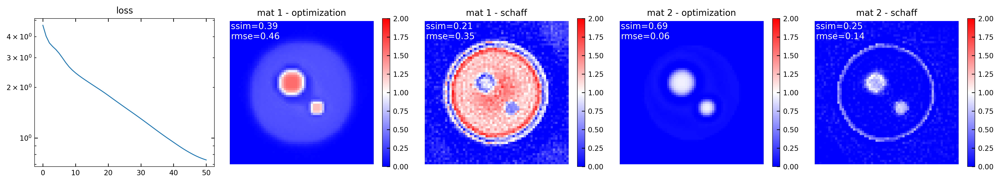

loss @ iter 100: 6.303e-01 (t = 7.6 s)


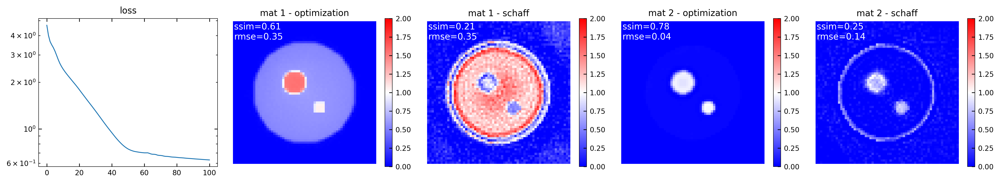

loss @ iter 150: 5.842e-01 (t = 10.8 s)


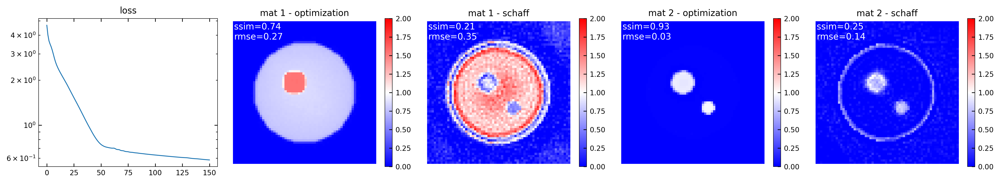

loss @ iter 200: 5.519e-01 (t = 13.9 s)


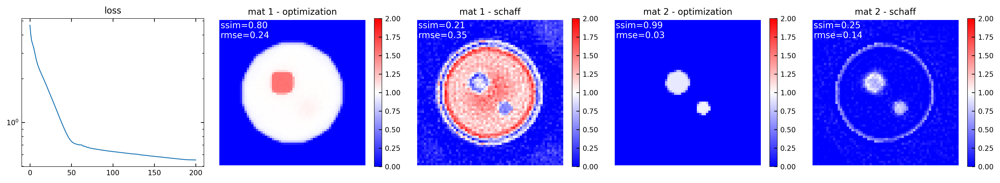

loss @ iter 250: 5.515e-01 (t = 17.0 s)


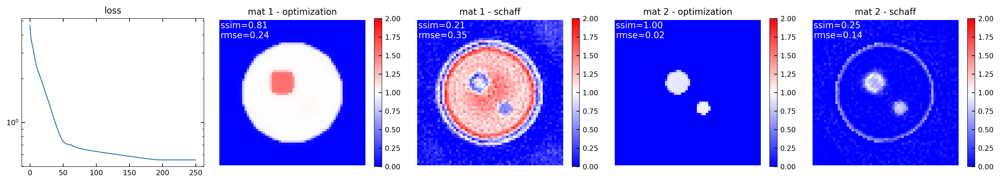

loss @ iter 300: 5.511e-01 (t = 20.0 s)


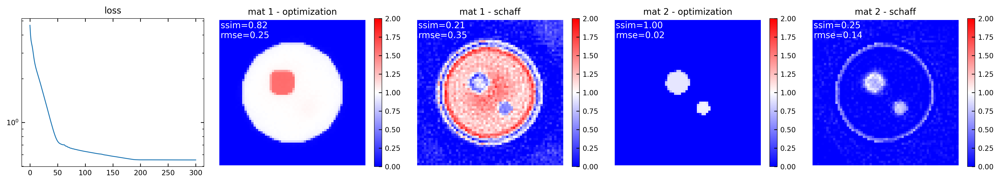

loss @ iter 350: 5.509e-01 (t = 23.1 s)


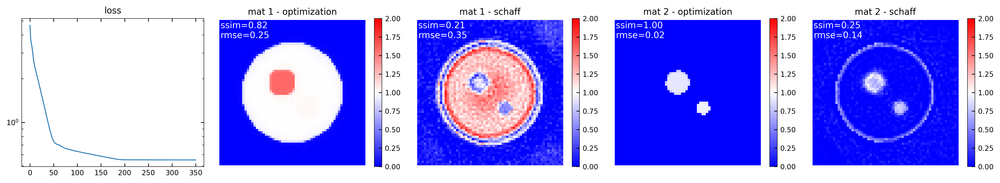

loss @ iter 400: 5.508e-01 (t = 26.1 s)


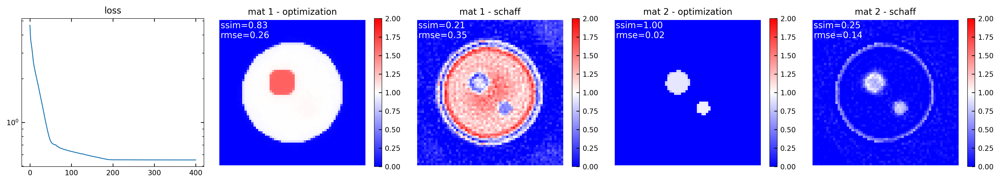

loss @ iter 450: 5.507e-01 (t = 29.2 s)


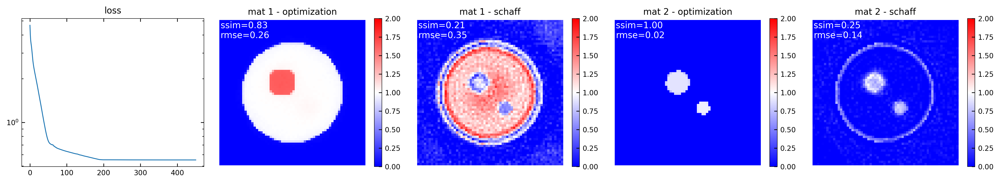

loss @ iter 500: 5.507e-01 (t = 32.2 s)


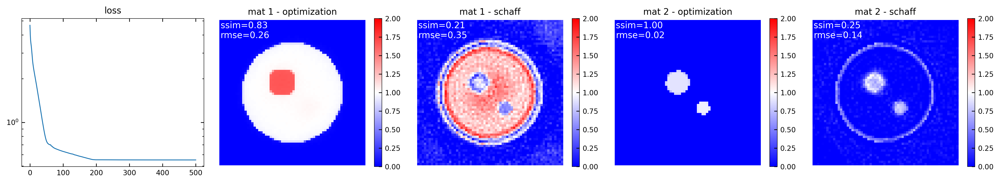

loss @ iter 550: 5.507e-01 (t = 35.2 s)


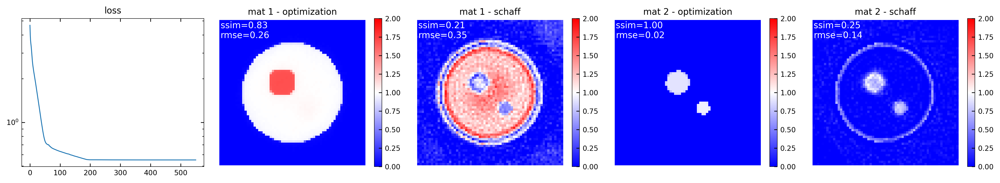

loss @ iter 600: 5.506e-01 (t = 38.3 s)


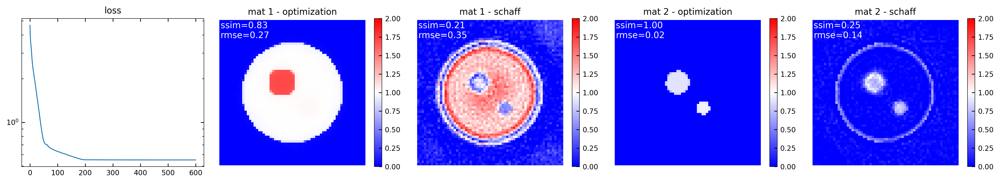

loss @ iter 650: 5.506e-01 (t = 41.4 s)


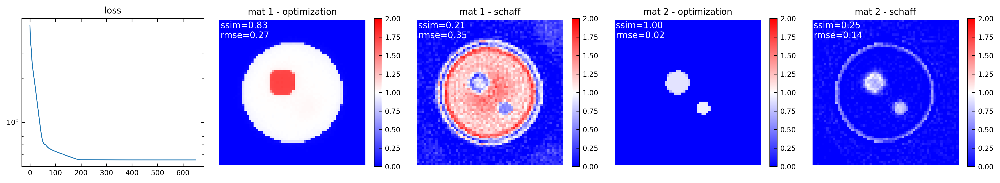

loss @ iter 700: 5.506e-01 (t = 44.4 s)


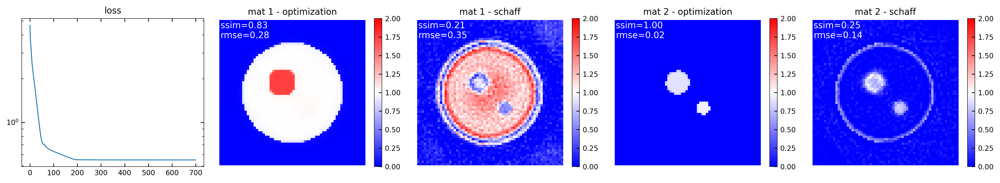

loss @ iter 750: 5.506e-01 (t = 47.5 s)


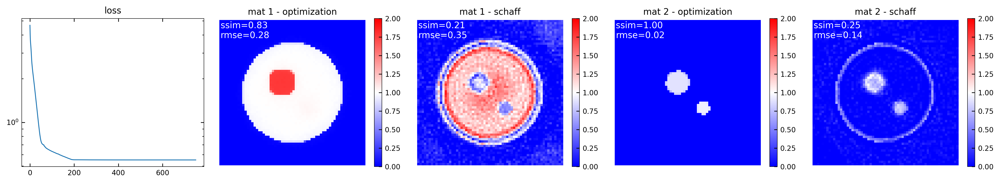

loss @ iter 800: 5.506e-01 (t = 50.5 s)


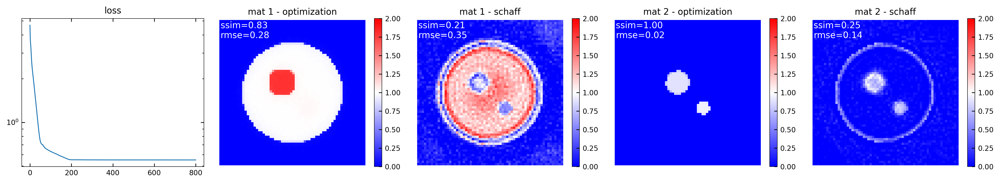

loss @ iter 850: 5.506e-01 (t = 53.6 s)


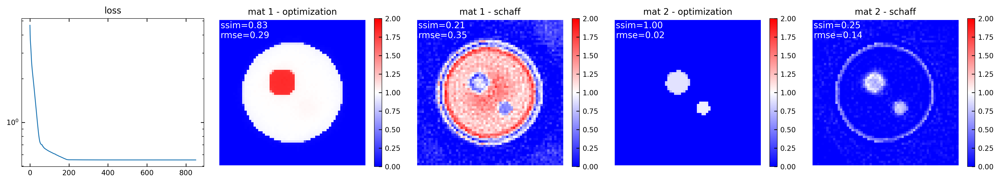

loss @ iter 900: 5.505e-01 (t = 56.6 s)


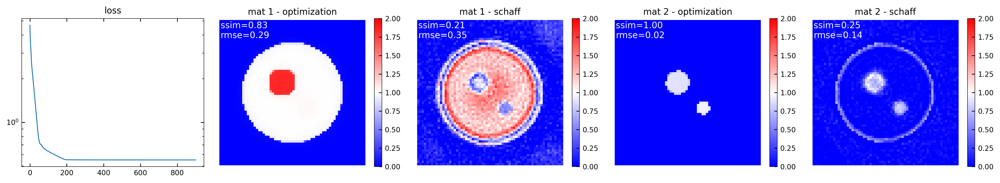

loss @ iter 950: 5.505e-01 (t = 59.7 s)


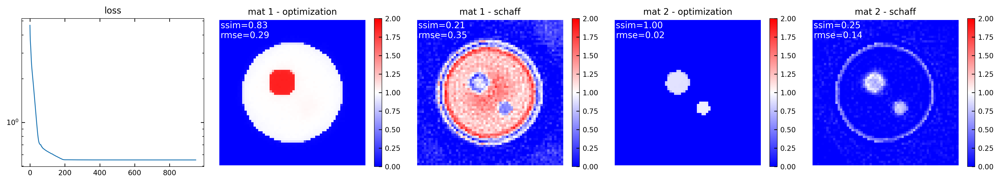

loss @ iter 1000: 5.505e-01 (t = 62.8 s)


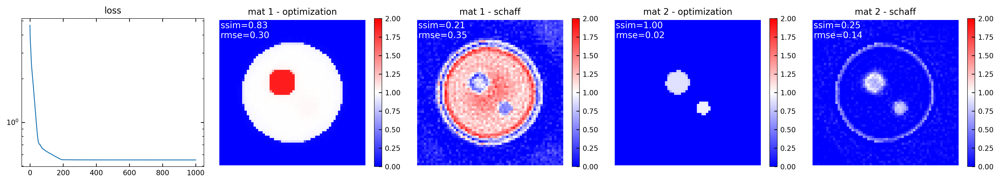

loss @ iter 1050: 5.505e-01 (t = 65.8 s)


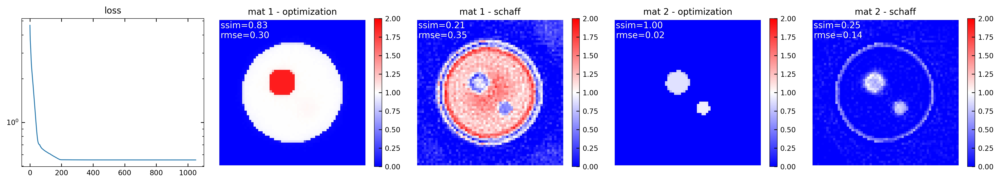

loss @ iter 1100: 5.505e-01 (t = 68.9 s)


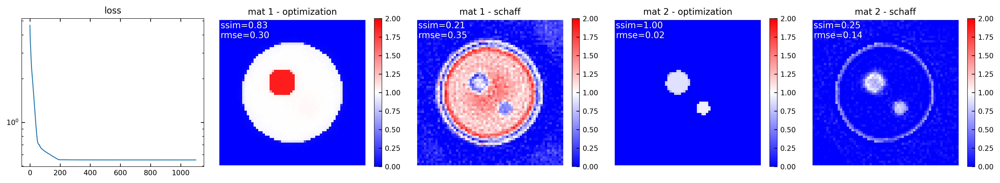

loss @ iter 1150: 5.505e-01 (t = 71.9 s)


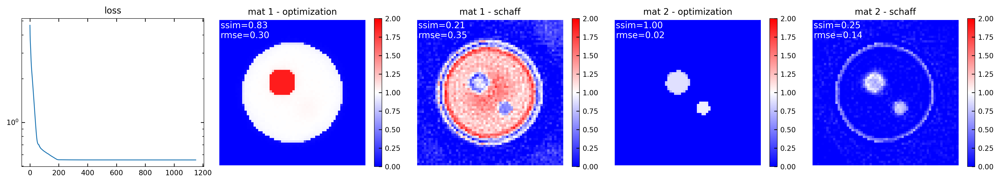

loss @ iter 1200: 5.505e-01 (t = 75.0 s)


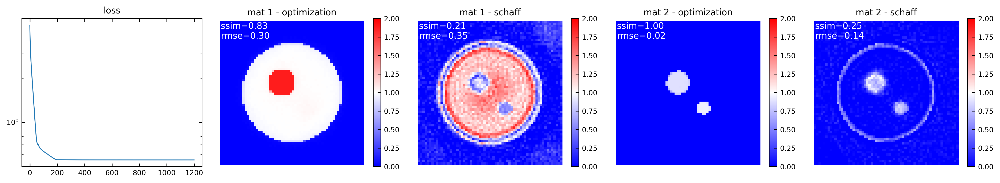

loss @ iter 1250: 5.504e-01 (t = 78.0 s)


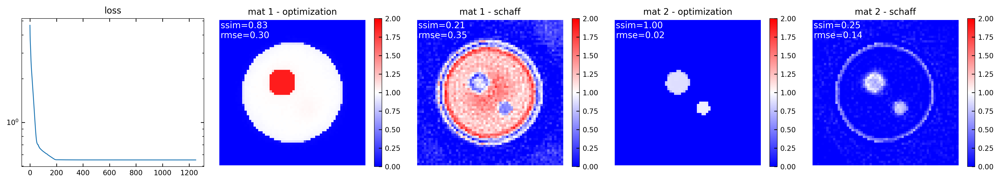

loss @ iter 1300: 5.504e-01 (t = 81.1 s)


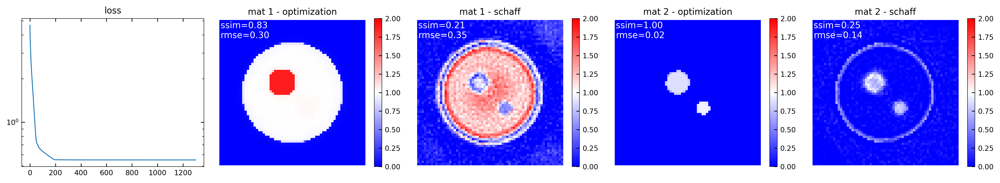

loss @ iter 1350: 5.504e-01 (t = 84.2 s)


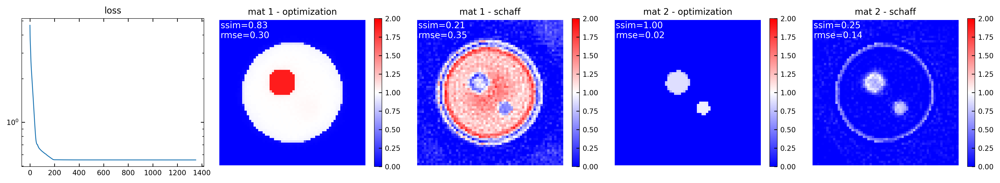

loss @ iter 1400: 5.504e-01 (t = 87.3 s)


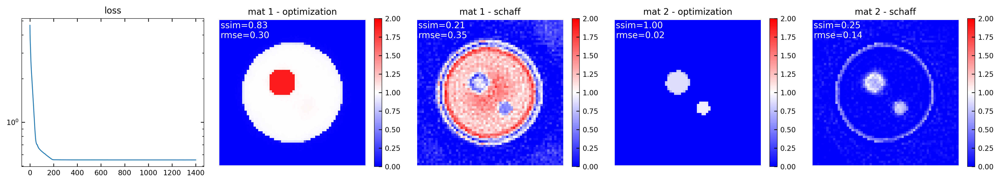

loss @ iter 1450: 5.504e-01 (t = 90.3 s)


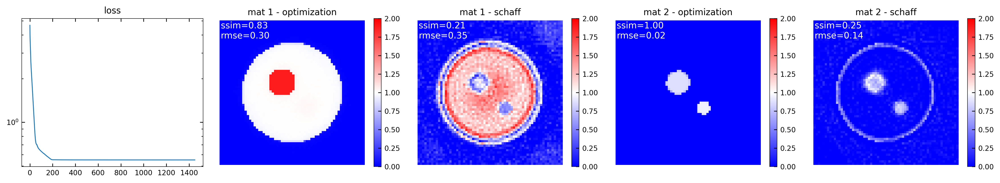

loss @ iter 1500: 5.503e-01 (t = 93.4 s)


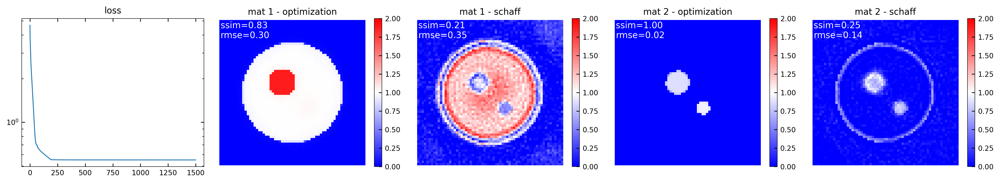

loss @ iter 50: 8.947e-01 (t = 4.4 s)


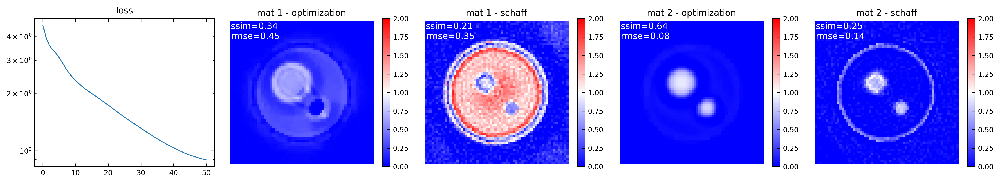

loss @ iter 100: 8.008e-01 (t = 7.5 s)


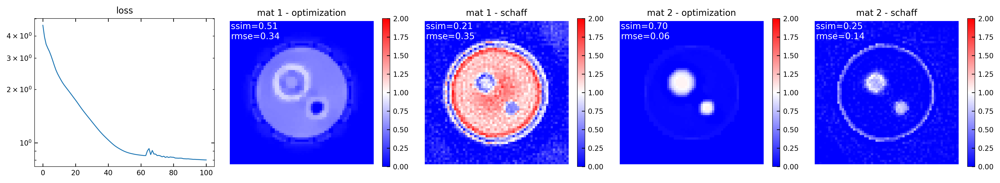

loss @ iter 150: 7.791e-01 (t = 10.6 s)


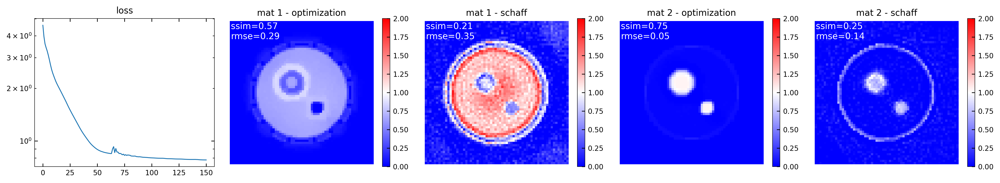

loss @ iter 200: 7.691e-01 (t = 13.7 s)


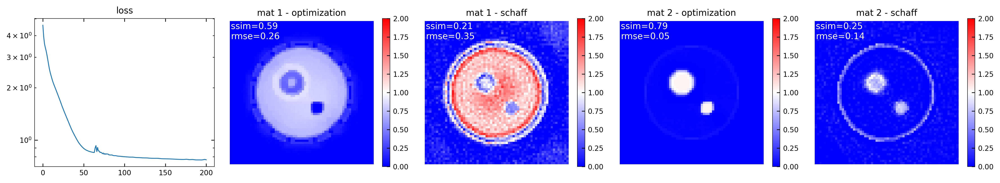

loss @ iter 250: 7.519e-01 (t = 16.7 s)


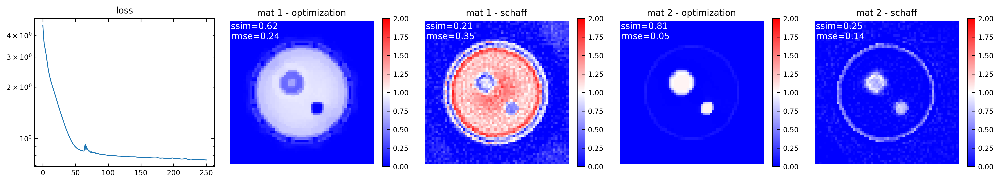

loss @ iter 300: 7.322e-01 (t = 19.8 s)


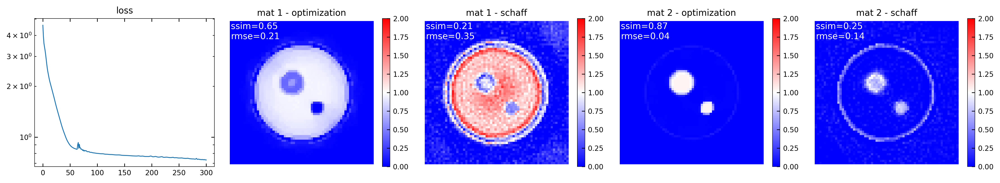

loss @ iter 350: 7.221e-01 (t = 22.9 s)


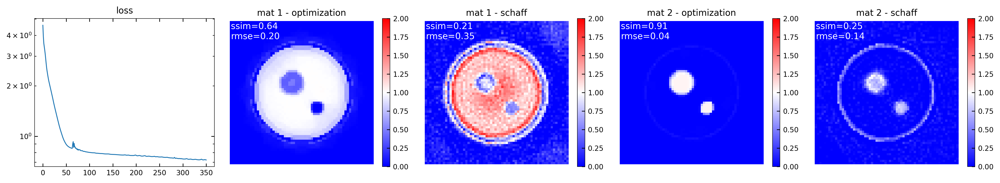

loss @ iter 400: 7.199e-01 (t = 26.1 s)


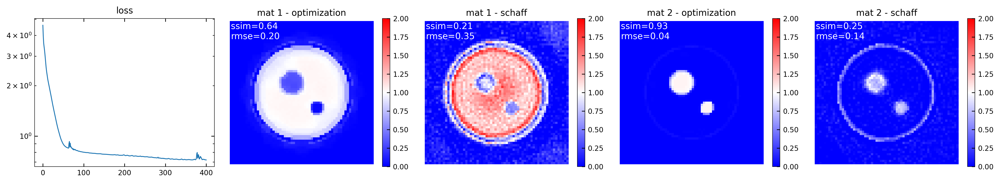

loss @ iter 450: 7.155e-01 (t = 29.2 s)


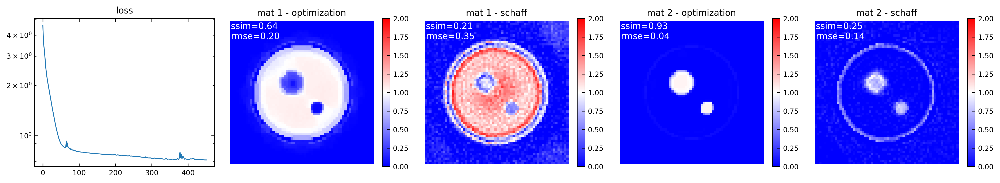

loss @ iter 500: 7.132e-01 (t = 32.3 s)


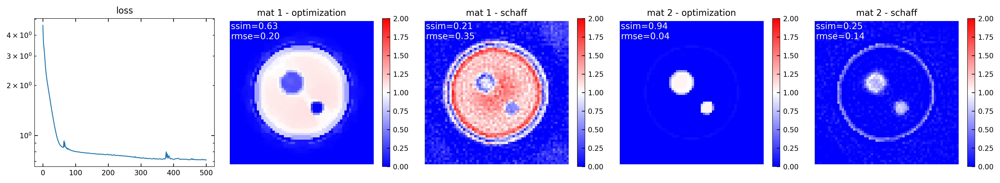

loss @ iter 550: 7.126e-01 (t = 35.4 s)


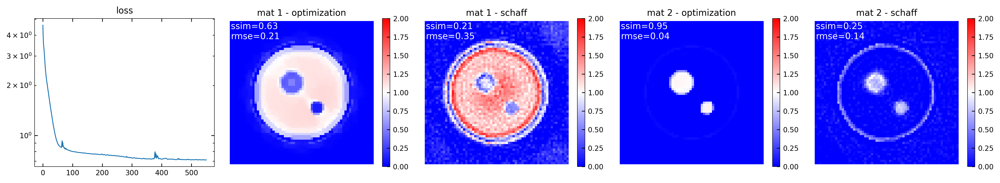

loss @ iter 600: 7.118e-01 (t = 38.5 s)


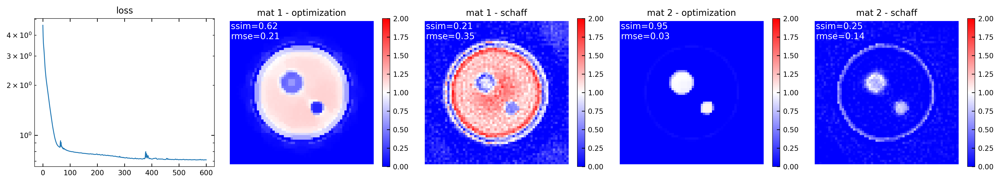

loss @ iter 650: 7.097e-01 (t = 41.6 s)


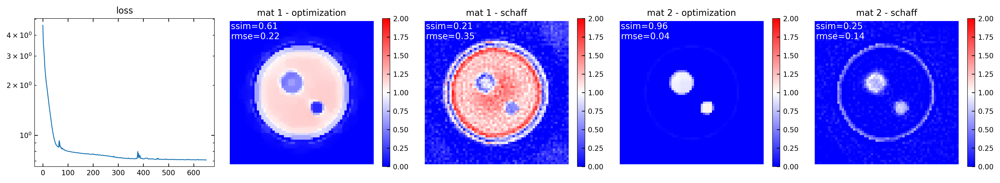

loss @ iter 700: 7.100e-01 (t = 44.7 s)


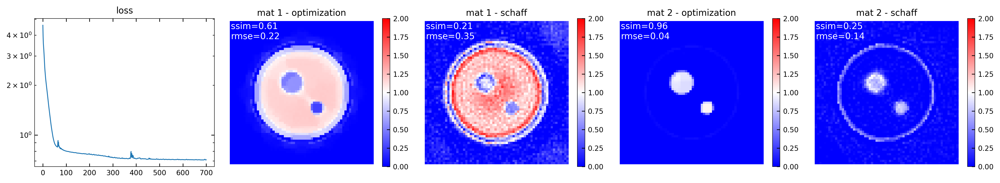

loss @ iter 750: 7.082e-01 (t = 47.8 s)


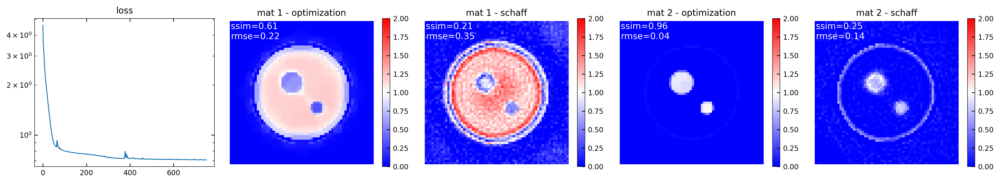

loss @ iter 800: 7.060e-01 (t = 50.9 s)


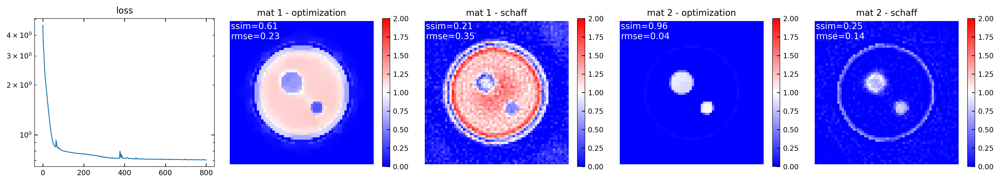

loss @ iter 850: 7.054e-01 (t = 54.0 s)


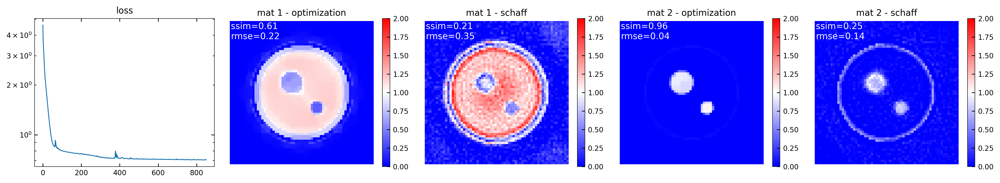

loss @ iter 900: 7.032e-01 (t = 57.0 s)


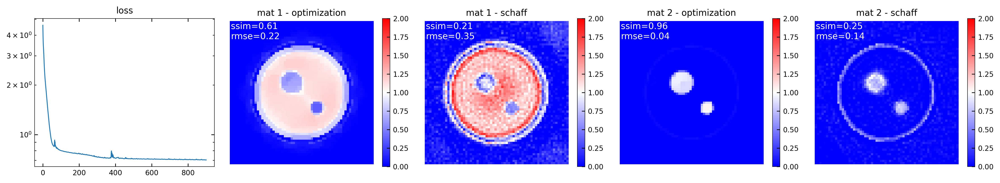

loss @ iter 950: 6.994e-01 (t = 60.1 s)


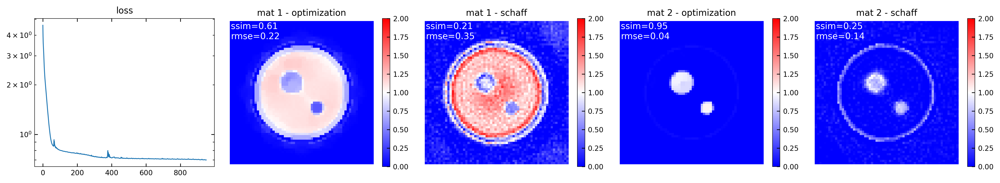

loss @ iter 1000: 7.049e-01 (t = 63.2 s)


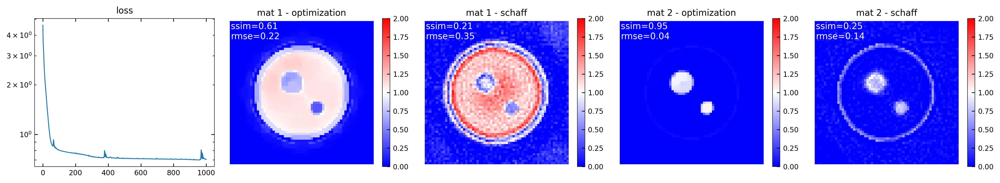

loss @ iter 1050: 7.025e-01 (t = 66.3 s)


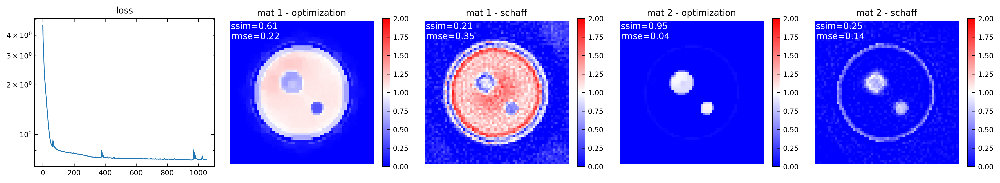

loss @ iter 1100: 6.995e-01 (t = 69.4 s)


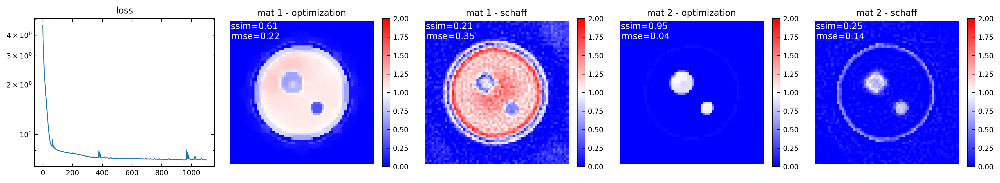

loss @ iter 1150: 6.996e-01 (t = 72.5 s)


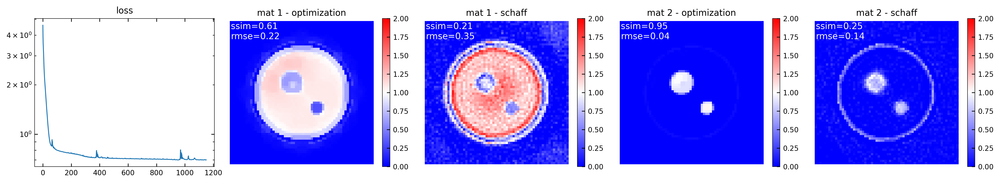

loss @ iter 1200: 6.998e-01 (t = 75.6 s)


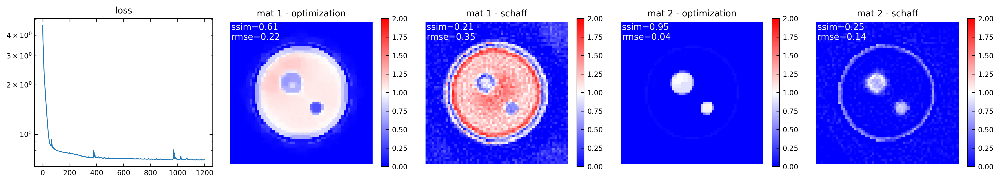

loss @ iter 1250: 6.987e-01 (t = 78.7 s)


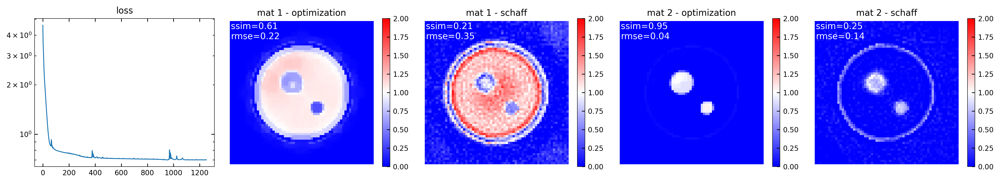

loss @ iter 1300: 7.016e-01 (t = 81.8 s)


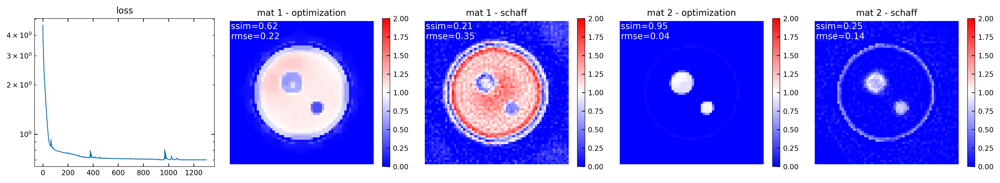

loss @ iter 1350: 6.988e-01 (t = 84.8 s)


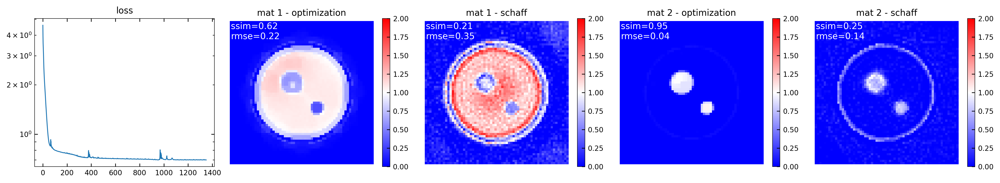

loss @ iter 1400: 7.005e-01 (t = 87.9 s)


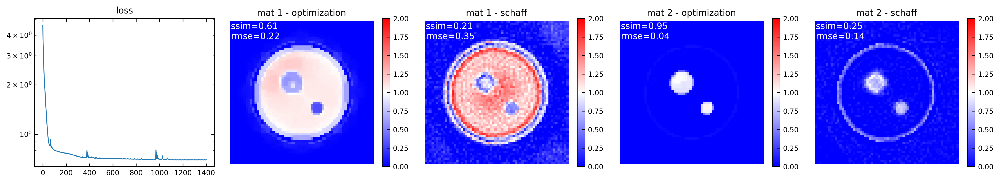

loss @ iter 1450: 7.021e-01 (t = 91.0 s)


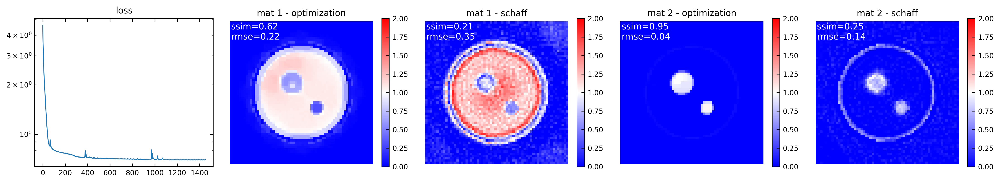

loss @ iter 1500: 7.021e-01 (t = 94.1 s)


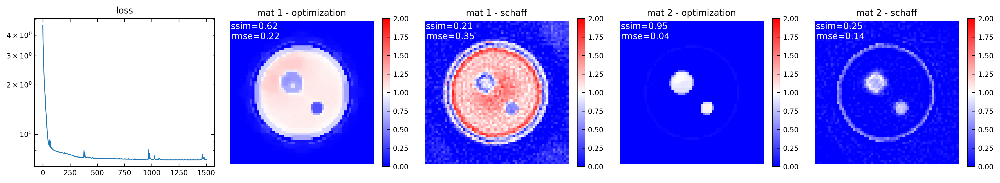

loss @ iter 50: 1.047e+00 (t = 4.5 s)


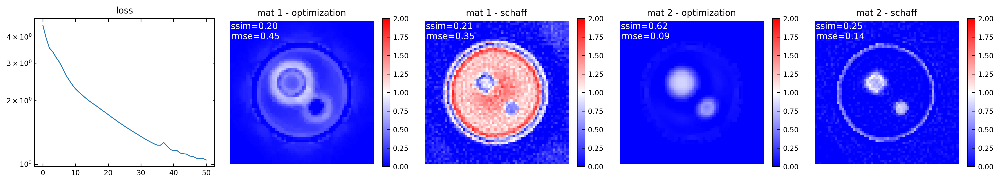

loss @ iter 100: 9.623e-01 (t = 14.1 s)


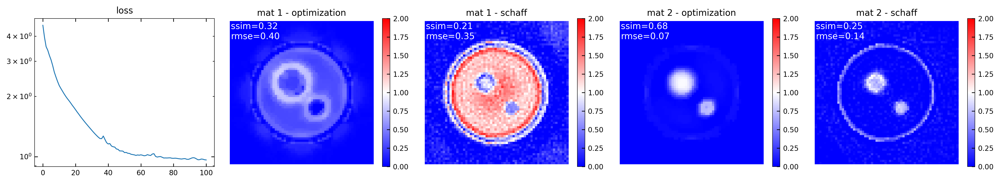

loss @ iter 150: 9.457e-01 (t = 17.2 s)


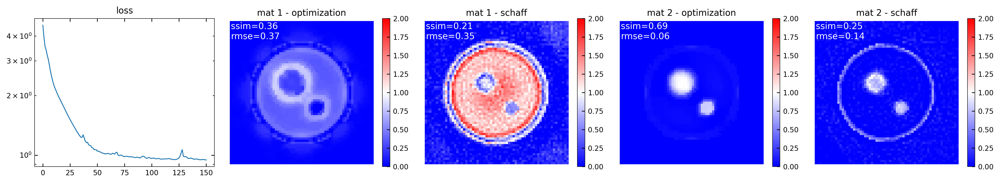

loss @ iter 200: 9.491e-01 (t = 20.3 s)


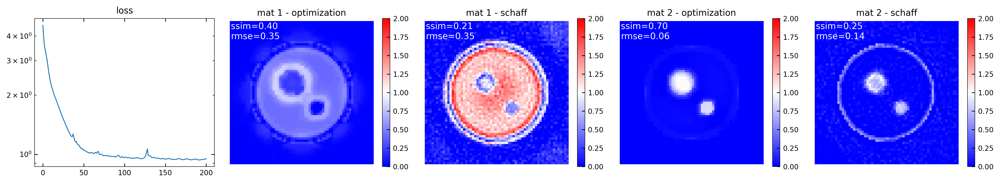

loss @ iter 250: 9.347e-01 (t = 23.4 s)


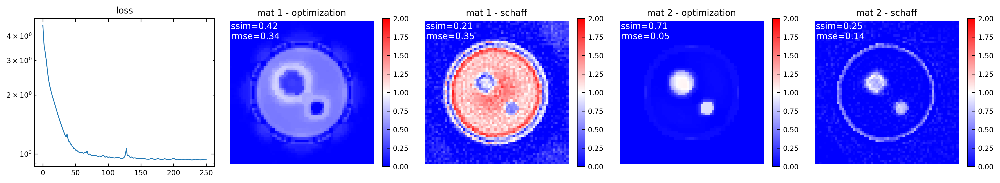

loss @ iter 300: 9.284e-01 (t = 26.5 s)


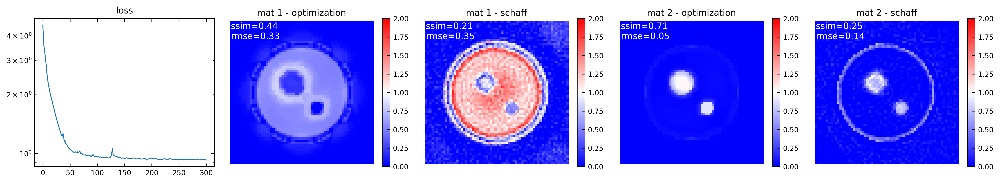

loss @ iter 350: 9.289e-01 (t = 29.6 s)


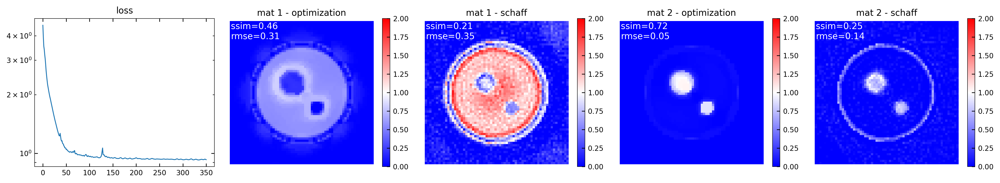

loss @ iter 400: 9.305e-01 (t = 32.7 s)


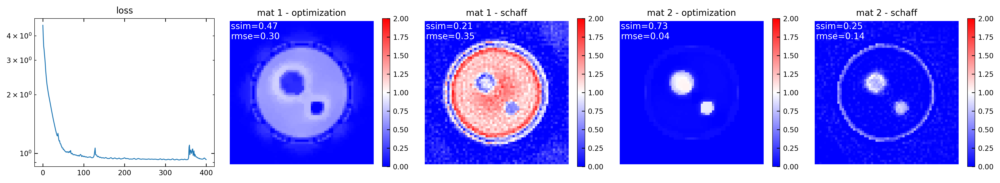

loss @ iter 450: 9.490e-01 (t = 35.8 s)


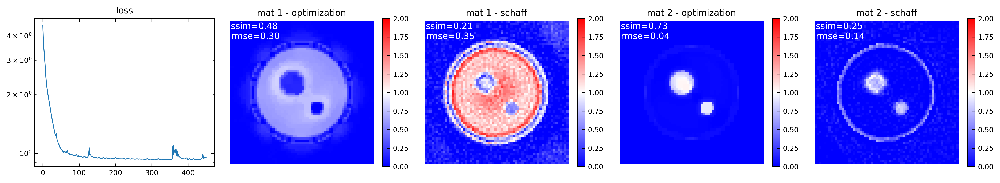

loss @ iter 500: 9.223e-01 (t = 38.9 s)


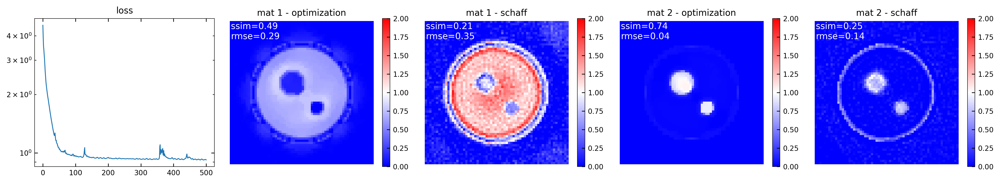

loss @ iter 550: 9.270e-01 (t = 42.0 s)


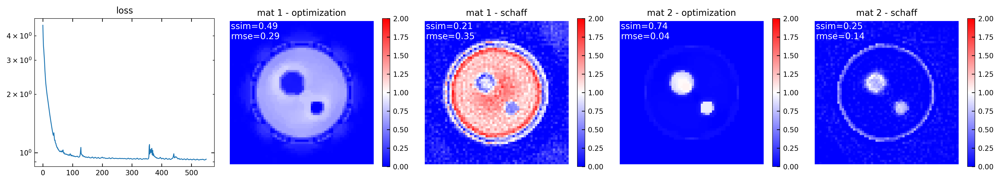

loss @ iter 600: 9.206e-01 (t = 45.1 s)


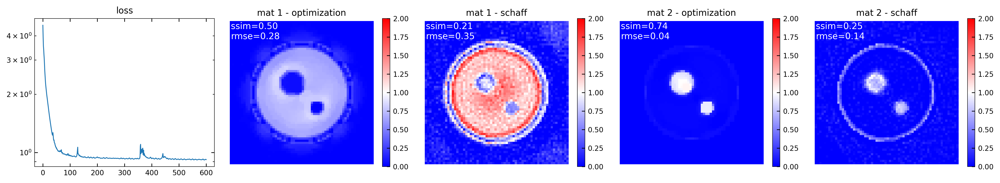

loss @ iter 650: 9.202e-01 (t = 48.1 s)


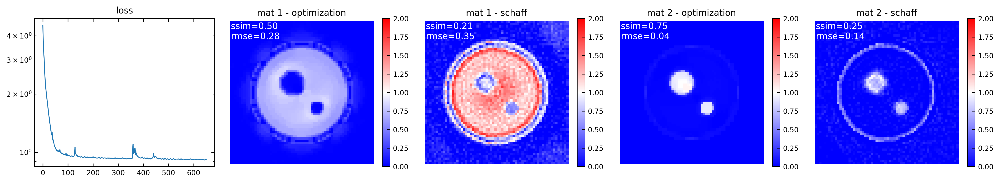

loss @ iter 700: 9.174e-01 (t = 51.2 s)


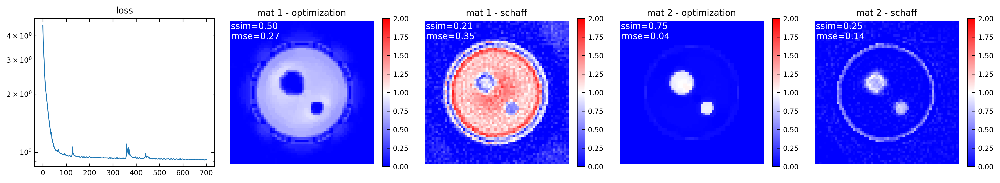

loss @ iter 750: 9.150e-01 (t = 54.3 s)


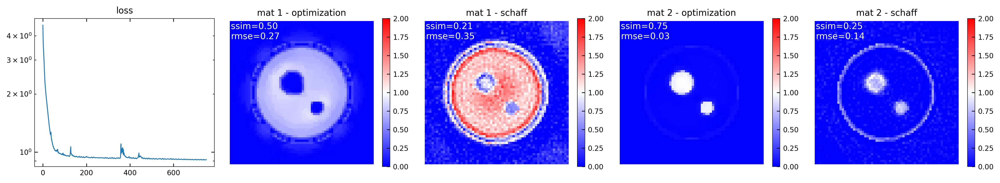

loss @ iter 800: 9.121e-01 (t = 57.4 s)


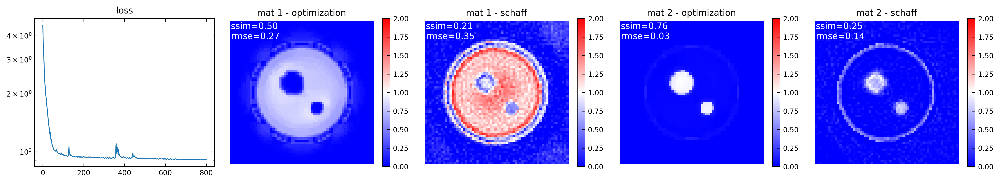

loss @ iter 850: 9.103e-01 (t = 60.5 s)


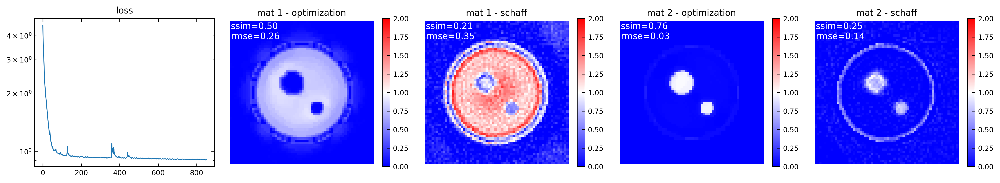

loss @ iter 900: 9.040e-01 (t = 63.7 s)


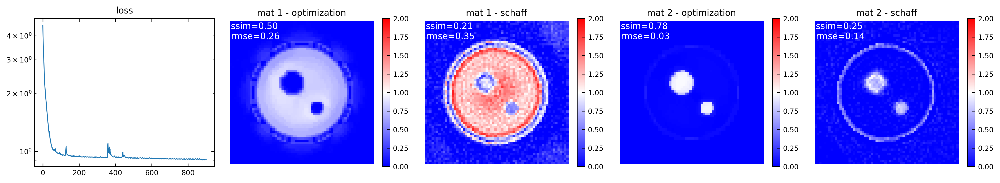

loss @ iter 950: 9.084e-01 (t = 66.8 s)


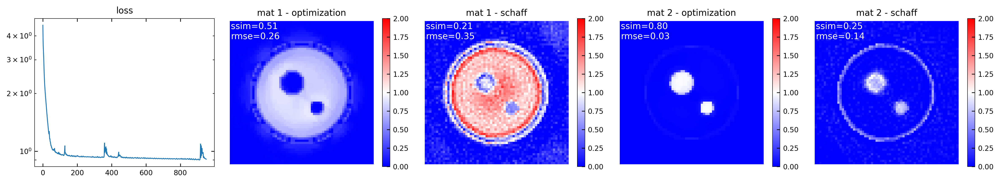

loss @ iter 1000: 8.990e-01 (t = 69.9 s)


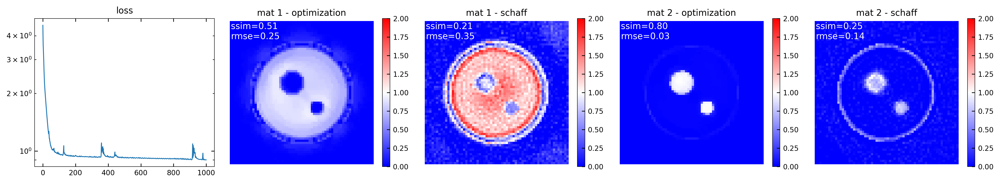

loss @ iter 1050: 9.438e-01 (t = 73.0 s)


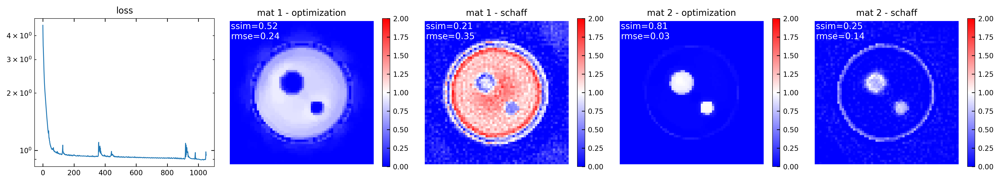

loss @ iter 1100: 8.931e-01 (t = 76.1 s)


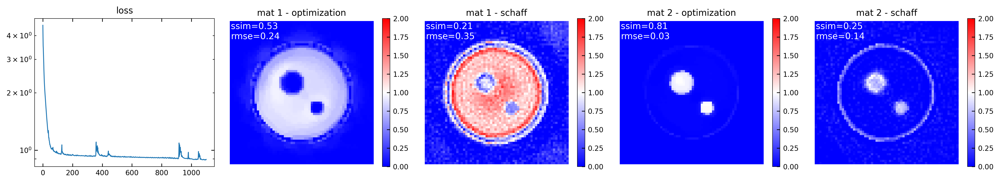

loss @ iter 1150: 9.189e-01 (t = 79.2 s)


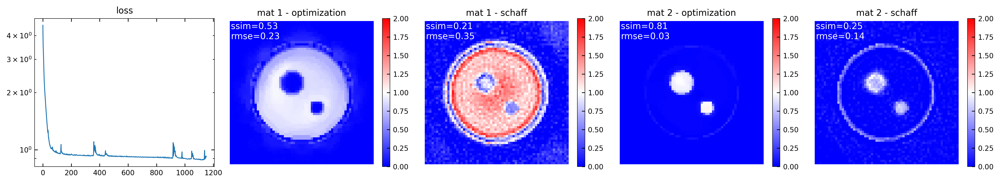

loss @ iter 1200: 8.810e-01 (t = 82.3 s)


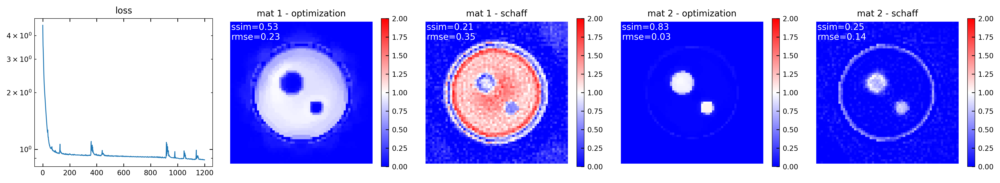

loss @ iter 1250: 8.789e-01 (t = 85.4 s)


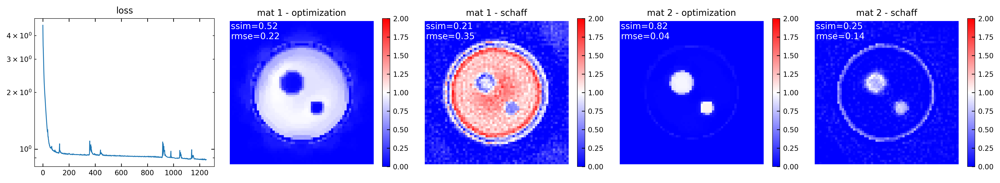

loss @ iter 1300: 8.741e-01 (t = 88.6 s)


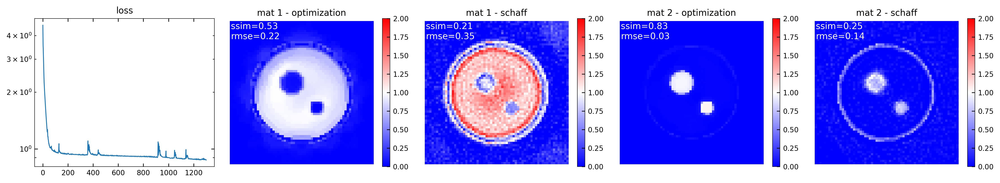

loss @ iter 1350: 8.765e-01 (t = 91.7 s)


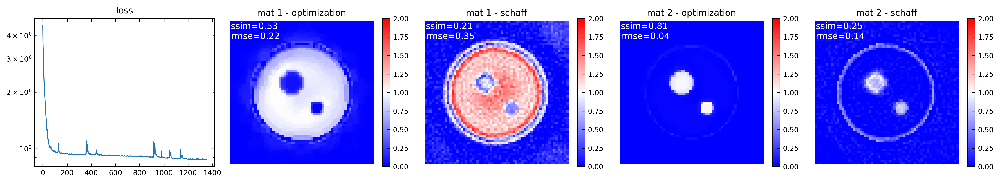

loss @ iter 1400: 8.717e-01 (t = 94.8 s)


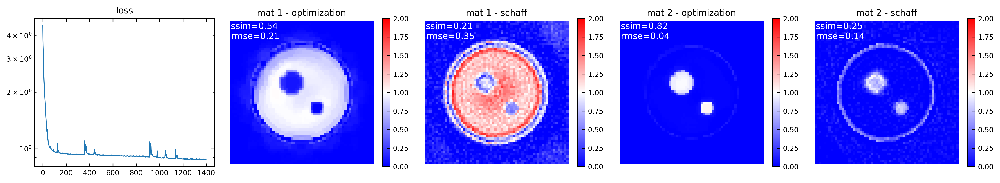

loss @ iter 1450: 8.716e-01 (t = 97.9 s)


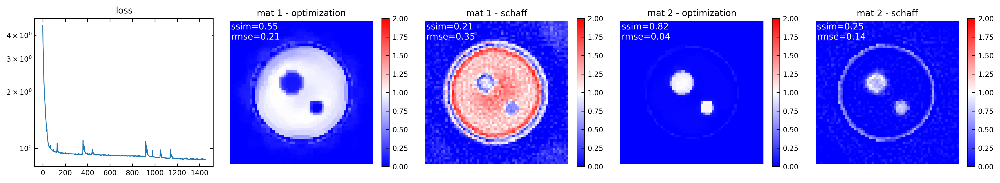

loss @ iter 1500: 8.664e-01 (t = 101.0 s)


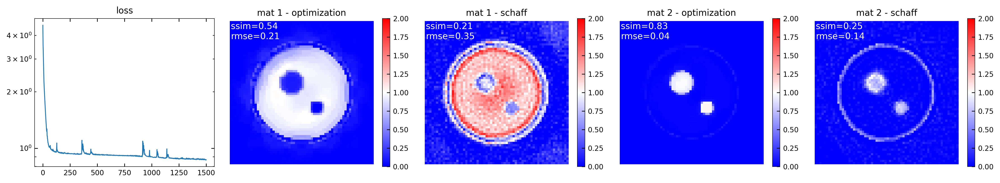

CPU times: user 10min 26s, sys: 1min 26s, total: 11min 52s
Wall time: 10min 57s


In [374]:
%%time

outd_main = 'f3d_output/par1/'

tot_theta = PI  
N_theta = 100
thetas = jnp.linspace(0, tot_theta*(1-1/N_theta), N_theta)

propdists = [0, 50e-3, 100e-3]

max_iter = 1500
show_iter = 50      
LRATE = 0.04
EPS = 1e-5
w_tv_mat1 = 1e-5  
w_tv_mat2 = 1e-5
w_l1_mat1 = 5e-6  
w_l1_mat2 = 1e-4  

for PROPDIST in propdists:
    outd = outd_main+f'{int(PROPDIST*1e3):03}mm/'
    os.makedirs(outd, exist_ok=True)
    
    def save_arr(arr, fname, dtype=np.float32, outd=outd):
        np.array(arr).astype(dtype).tofile(outd+fname)

    class MultiMatPBI(nn.Module):
    
        # Simulation settings
        propdist = PROPDIST
        energies = jnp.array([24, 34])  
        material_basis = {1:tissue, 2:bone}  
                 
        # Phantom
        phantom_fov: float = 0.625e-3  #0.5e-3
        phantom_dx: float = phantom_fov / 64
        phantom_Nx: int = 64
        phantom_Ny: int = 20
    
        # Detector
        det_Nx: int = phantom_Nx   # for now, set the same.
        det_Ny: int = phantom_Ny
        det_fwhm: float = 10e-6
        det_psf: str = 'lorentzian'  # code for the PSF is in fun.py
        resampling_method: str = 'linear'
        I0: int = 1e11 / (phantom_Nx**2) # should normalize this to pixel size later
    
        # Misc.
        ds1, bs1 = material_basis[1].delta_beta(energies)
        ds2, bs2 = material_basis[2].delta_beta(energies)
        n1 = (ds1 + 1j*bs1) / material_basis[1].density  # normalized to the default density!!
        n2 = (ds2 + 1j*bs2) / material_basis[2].density
        det_fov: float = phantom_fov
        det_dx: float = det_fov / det_Nx
        wavelens = get_wavelen(energies)
        N_pad: int = 100
        n_medium: float = 1  
        
        def setup(self):
            self.volume = self.param(
                'volume',
                lambda key, shape: jnp.full(shape, 1e-3, dtype=jnp.float32),
                (self.phantom_Nx, self.phantom_Ny, self.phantom_Nx, len(self.material_basis)),
            )
            self.det_resample_func = init_plane_resample(
                (self.det_Nx, self.det_Ny), 
                (self.det_dx, self.det_dx), 
                resampling_method=self.resampling_method
            )
        
        def __call__(self, angle: float) -> Array:
            Nx, Ny, Nz = self.phantom_Nx, self.phantom_Ny, self.phantom_Nx
            vol_db_mat1 = jnp.tile(self.n1, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
            vol_db_mat2 = jnp.tile(self.n2, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
            volume = vol_db_mat1 * jnp.stack([self.volume[:,:,:,0], self.volume[:,:,:,0]], axis=-1) + vol_db_mat2 * jnp.stack([self.volume[:,:,:,1], self.volume[:,:,:,1]], axis=-1)
            volume = jnp.stack([volume.imag, volume.real], axis=0)
            
            field = cx.plane_wave(
                shape = (self.phantom_Nx, self.phantom_Ny),
                dx = self.phantom_dx,
                spectrum = self.wavelens,
                spectral_density = jnp.ones(self.wavelens.size)
            ) 
            field = field / field.intensity.max()**0.5 / (self.phantom_Nx / self.det_Nx) / (self.phantom_Ny / self.det_Ny) 
            cval = field.intensity.max()
    
            rotated_vol = jax.vmap(
                rotate_volume_4d,
                in_axes=(0, None)
            )(volume, angle)
    
            vol_proj = jnp.sum(rotated_vol, axis=3)
            beta_proj = vol_proj[0, None, ..., None]
            dn_proj = vol_proj[1, None, ..., None]
            exit_field = cx.thin_sample(field, beta_proj, dn_proj, self.phantom_dx)
    
            det_field = cx.transfer_propagate(exit_field, self.propdist, self.n_medium, self.N_pad, cval=cval, mode='same')
            imgs = self.det_resample_func(det_field.amplitude.squeeze()[..., None], field.dx.ravel()[:1])[...,0]
    
            imgs = jax.vmap(
                lambda img: apply_psf(img, self.det_fov, self.det_dx, psf=self.det_psf, fwhm=self.det_fwhm, kernel_width=0.1),
                in_axes = -1,
                out_axes = -1
            )(imgs)
            imgs = imgs.swapaxes(0,1)
            
            return imgs
            
    ################################################################
    ################################################################

    # Set up model
    key = jax.random.PRNGKey(3)
    model = MultiMatPBI()
    params = model.init(key, 0)
    
    Nx, Ny = model.phantom_Nx, model.phantom_Ny
    vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.2, p2=0.1, id2=2, c1=1, c2=3)
    subvol_raw = vol_raw[:,(Nx-Ny)//2:(Nx+Ny)//2,:]
    density_phantom = np.zeros([Nx, Ny, Nx, len(model.material_basis)])
    for i, item in enumerate(model.material_basis.items()):
        idx, mat = item
        density_phantom[:,:,:,i][subvol_raw==idx] = mat.density       
    params = unfreeze(params)
    params['params']['volume'] = density_phantom
    params = freeze(params)
    save_arr(density_phantom, 'phantom.bin')
    
    # Simulate
    forward = jax.jit(jax.vmap(model.apply, in_axes=(None, 0)))
    data = forward(params, thetas)
    save_arr(data, 'data_noiseless.bin')
    
    data = jax.random.poisson(key, model.I0*data, data.shape) / model.I0  # noise
    save_arr(data, 'data.bin')

    # Raw recon
    recon_data = np.zeros(density_phantom.shape)
    for z_level in range(density_phantom.shape[1]):
        sino = -np.log(data[:,z_level,:,:]**2)
        recon_data[:,z_level,:,0] = get_recon(sino[:,:,0], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        recon_data[:,z_level,:,1] = get_recon(sino[:,:,1], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
    save_arr(recon_data, 'recon.bin')


    # #################################################################
    #### Schaff recon    

    Na, Nu, Nv, Ne = data.shape
    distances = model.propdist
    px = model.det_dx
    ds = -np.array([model.ds1, model.ds2])
    mus = 2 * np.array([model.bs1, model.bs2]) * get_wavenum(np.stack([model.energies, model.energies]))

    data_Schaff = np.zeros(data.shape)
    for idx in range(N_theta):
        t1, t2 = spbi_material_basis([data[idx,:,:,e]**2 for e in range(2)], distances, px, ds.T, mus.T) 
        data_Schaff[idx,:,:,0] = t1
        data_Schaff[idx,:,:,1] = t2
        
    vol_Schaff = np.zeros(density_phantom.shape)
    for z_level in range(density_phantom.shape[1]):
        vol_Schaff[::-1,z_level,::-1,0] = model.material_basis[1].density * get_recon(data_Schaff[:,z_level,:,0], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
        vol_Schaff[::-1,z_level,::-1,1] = model.material_basis[2].density * get_recon(data_Schaff[:,z_level,:,1], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
    save_arr(vol_Schaff, 'vol_tie.bin')

    # ################################################################
    #### Optimize

    
    key = jax.random.PRNGKey(3)
    model = MultiMatPBI()
    params = model.init(key, 0)
    forward = jax.vmap(model.apply, in_axes=(None, 0))  
    optimizer = optax.adam(learning_rate=LRATE, eps=EPS)
    opt_state = optimizer.init(params)  
    
    def loss_fn(params, data):
        vol = params['params']['volume']
        vol1, vol2 = vol[:,:,:,0], vol[:,:,:,1]   
        y_k = forward(params, thetas)   
        loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv_mat1*TV(vol1) + w_tv_mat2*TV(vol2) + w_l1_mat1*L1(vol1) + w_l1_mat2*L1(vol2)
        return loss
        
    @jax.jit  
    def update(params, opt_state, *args):
        loss, grads = jax.value_and_grad(loss_fn)(params, *args)
        updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
        params = projection_non_negative(optax.apply_updates(params, updates))
        return params, opt_state, loss
    
    loss = []
    t0 = time()
    for k in range(max_iter+1):
        params, opt_state, loss_k = update(params, opt_state, data)
        loss.append(loss_k)
        if k%show_iter == 0 and k>0:
            print(f'loss @ iter {k}: {loss_k:.3e} (t = {time()-t0:.1f} s)')
            show_compare(params, loss, density_phantom, recon1=recon1, recon2=recon2)
            save_arr(params['params']['volume'], f'vol_{k:04}.bin')
    save_arr(loss, 'loss.bin')


# Optimize

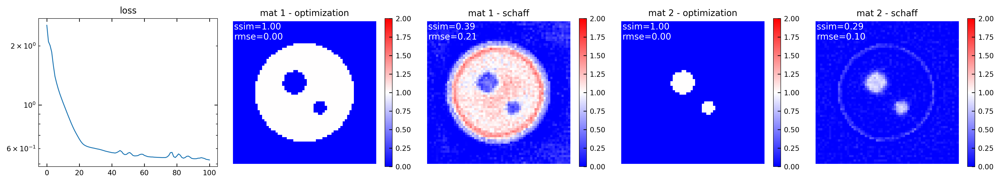

In [280]:


def show_compare(params, loss, vol_truth, data_range=2, recon1=recon1, recon2=recon2):
    vol1 = params['params']['volume']
    d1 = model.material_basis[1].density
    d2 = model.material_basis[2].density
    vol2 = np.array([d1*recon1, d2*recon2])   
    idx = vol1.shape[1]//2
    
    kw = {'vmin':0, 'vmax':2, 'cmap':'bwr'}
    fig, ax = plt.subplots(1,5,figsize=[16,3], dpi=300)
    ax[0].set_title('loss')
    ax[0].plot(loss)
    ax[0].set_yscale('log')
    for i in range(2):
        im1 = vol1[:,idx,:,i].clip(0, data_range) / model.material_basis[i+1].density
        im2 = vol2[i][::-1,::-1].clip(0, data_range) / model.material_basis[i+1].density
        im_truth = vol_truth[:,idx,:,i] / model.material_basis[i+1].density

        axi = ax[1 + 2*i] 
        axi.set_title(f'mat {i+1} - optimization')
        m = axi.imshow(im1  , **kw) 
        fig.colorbar(m, ax=axi)
        ssim1 = ssim(im1, im_truth, data_range=data_range)
        rmse1 = rmse(im1, im_truth)
        axi.text(0, 0, f'ssim={ssim1:.2f} \nrmse={rmse1:.2f}', color='w', va='top', ha='left')

        axi = ax[2 + 2*i]  
        axi.set_title(f'mat {i+1} - schaff')
        m = axi.imshow(im2 , **kw)
        fig.colorbar(m, ax=axi)
        ssim2 = ssim(im2, im_truth, data_range=data_range)
        rmse2 = rmse(im2, im_truth)
        axi.text(0, 0, f'ssim={ssim2:.2f} \nrmse={rmse2:.2f}', color='w', va='top', ha='left')

    for axi in ax[1:]:
        axi.axis('off')
    fig.tight_layout()
    plt.show()

def get_metrics(params, vol_truth, data_range=2):
    vol1 = params['params']['volume']
    d1 = model.material_basis[1].density
    d2 = model.material_basis[2].density
    vol2 = np.array([d1*recon1, d2*recon2])  
    idx = vol1.shape[1]//2

    metrics = []
    for i in range(2):  
        metd = {'ssim':{}, 'rmse':{}}
        im1 = vol1[:,idx,:,i].clip(0, data_range) / model.material_basis[i+1].density
        im2 = vol2[i][::-1,::-1].clip(0, data_range) / model.material_basis[i+1].density
        im_truth = vol_truth[:,idx,:,i] / model.material_basis[i+1].density
        metd['ssim']['opt'] = ssim(im1, im_truth, data_range=data_range)
        metd['rmse']['opt'] = rmse(im1, im_truth)
        metd['ssim']['schaff'] = ssim(im2, im_truth, data_range=data_range)
        metd['rmse']['schaff'] = rmse(im2, im_truth)
        metrics.append(metd)
    return metrics
    
show_compare(params, loss, density_phantom)
# get_metrics(params, density_phantom)

In [317]:
%%time

truth = data

max_iter = 200
EPS = 1e-5
ivol = 1e-3

best_ssim = 0
all_pars = []
all_ssims = []

for LRATE in [0.04, 0.045, 0.05]:
    for w_tv_mat1 in [0.8e-5, 1e-5, 1.2e-5]:   
        for w_tv_mat2 in [0, 1e-6, 1e-5, 1e-4]:  
            for w_l1_mat1 in [0, 0.5e-6, 1e-6, 1.5e-6]:   
                for w_l1_mat2 in [1e-4, 1.5e-4, 1e-3]:   

                    key = jax.random.PRNGKey(3)
                    model = MultiMatPBI()
                    params = model.init(key, 0)
                    
                    params = unfreeze(params)
                    params['params']['volume'] = ivol * np.ones(density_phantom.shape, dtype=np.float32)
                    params = freeze(params)
                    
                    forward = jax.vmap(model.apply, in_axes=(None, 0))  
                    optimizer = optax.adam(learning_rate=LRATE, eps=EPS)
                    opt_state = optimizer.init(params)  
                    
                    def loss_fn(params, data=truth):
                        vol = params['params']['volume']
                        vol1, vol2 = vol[:,:,:,0], vol[:,:,:,1]   # separate the material volumes
                        y_k = forward(params, thetas)   
                        loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv_mat1*TV_3d(vol1) + w_tv_mat2*TV_3d(vol2) + w_l1_mat1*L1(vol1) + w_l1_mat2*L1(vol2)
                        return loss
                        
                    @jax.jit  
                    def update(params, opt_state, *args):
                        loss, grads = jax.value_and_grad(loss_fn)(params, *args)
                        updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
                        params = projection_non_negative(optax.apply_updates(params, updates))
                        return params, opt_state, loss
                    
                    t0 = time()
                    for k in range(max_iter+1):
                        params, opt_state, loss_k = update(params, opt_state, data)

                    metrics = get_metrics(params, density_phantom)
                    these_params = [LRATE, w_tv_mat1, w_tv_mat2, w_l1_mat1, w_l1_mat2]
                    tot_ssim = metrics[0]['ssim']['opt'] + metrics[1]['ssim']['opt']

                    all_pars.append(these_params)
                    all_ssims.append(tot_ssim)
                    
                    print(f'total ssim = {tot_ssim:.3f} (t = {time()-t0:.1f} s)', these_params)
                    if (tot_ssim > best_ssim):
                        best_params = these_params
    


total ssim = 1.499 (t = 10.8 s) [0.04, 8e-06, 0, 0, 0.0001]
total ssim = 1.481 (t = 10.8 s) [0.04, 8e-06, 0, 0, 0.00015]
total ssim = 1.281 (t = 10.8 s) [0.04, 8e-06, 0, 0, 0.001]
total ssim = 1.499 (t = 10.8 s) [0.04, 8e-06, 0, 5e-07, 0.0001]
total ssim = 1.480 (t = 10.8 s) [0.04, 8e-06, 0, 5e-07, 0.00015]
total ssim = 1.301 (t = 10.8 s) [0.04, 8e-06, 0, 5e-07, 0.001]
total ssim = 1.489 (t = 10.9 s) [0.04, 8e-06, 0, 1e-06, 0.0001]
total ssim = 1.478 (t = 10.8 s) [0.04, 8e-06, 0, 1e-06, 0.00015]
total ssim = 1.312 (t = 10.8 s) [0.04, 8e-06, 0, 1e-06, 0.001]
total ssim = 1.487 (t = 10.7 s) [0.04, 8e-06, 0, 1.5e-06, 0.0001]
total ssim = 1.486 (t = 10.8 s) [0.04, 8e-06, 0, 1.5e-06, 0.00015]
total ssim = 1.318 (t = 10.8 s) [0.04, 8e-06, 0, 1.5e-06, 0.001]
total ssim = 1.500 (t = 10.7 s) [0.04, 8e-06, 1e-06, 0, 0.0001]
total ssim = 1.480 (t = 10.7 s) [0.04, 8e-06, 1e-06, 0, 0.00015]
total ssim = 1.282 (t = 10.7 s) [0.04, 8e-06, 1e-06, 0, 0.001]
total ssim = 1.500 (t = 10.7 s) [0.04, 8e-06, 

################################################
optimizer learning rate: 0.04
mat 1 TV weight: 1.2e-05
mat 2 TV weight: 1e-05
mat 1 L1 weight: 0
mat 2 L1 weight: 0.0001
loss @ iter 20: 1.700e+00 (t = 3.1 s)


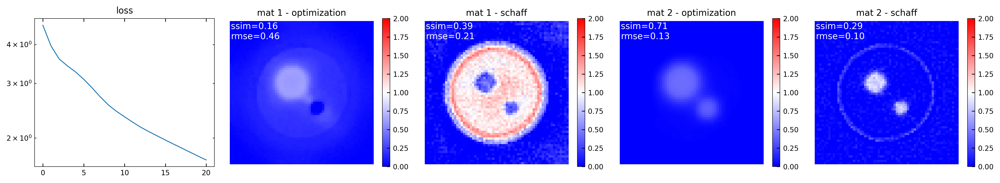

loss @ iter 40: 9.841e-01 (t = 4.9 s)


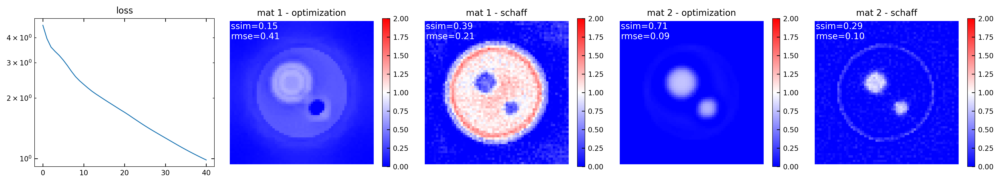

loss @ iter 60: 7.726e-01 (t = 6.7 s)


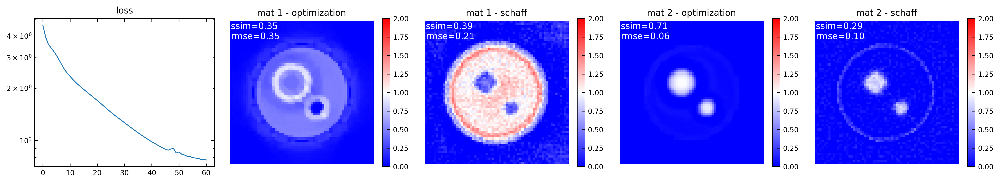

loss @ iter 80: 7.255e-01 (t = 8.6 s)


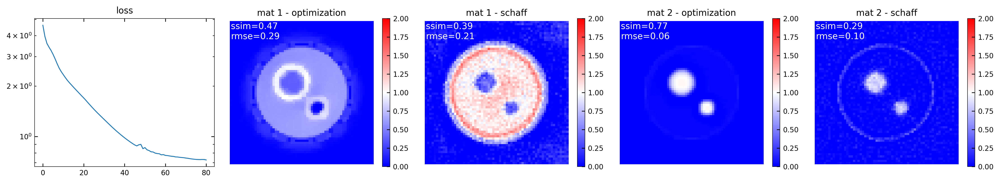

loss @ iter 100: 6.878e-01 (t = 10.4 s)


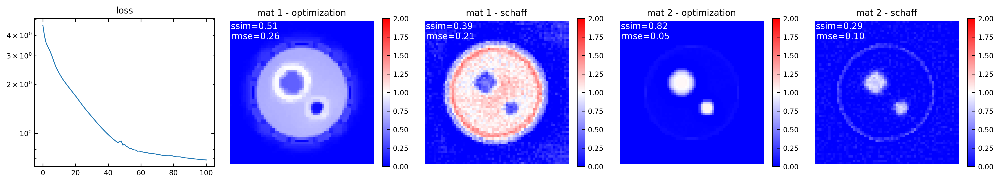

loss @ iter 120: 6.643e-01 (t = 12.2 s)


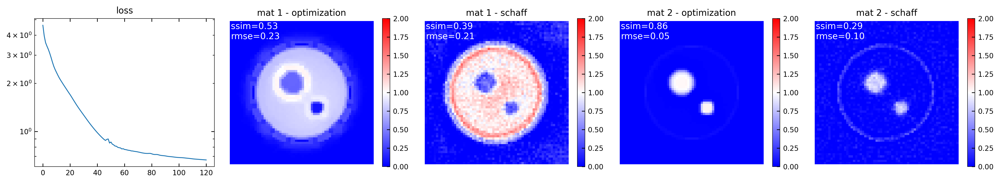

loss @ iter 140: 6.473e-01 (t = 14.1 s)


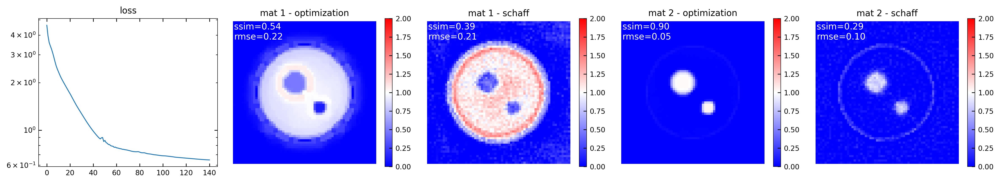

loss @ iter 160: 6.351e-01 (t = 15.9 s)


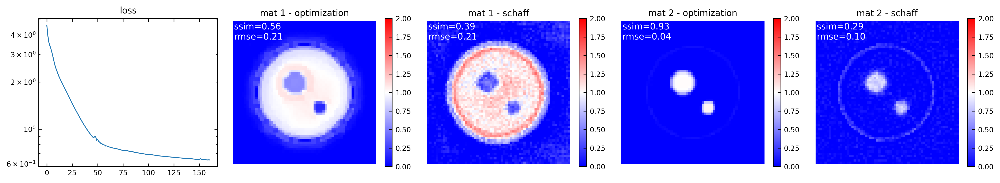

loss @ iter 180: 6.202e-01 (t = 17.8 s)


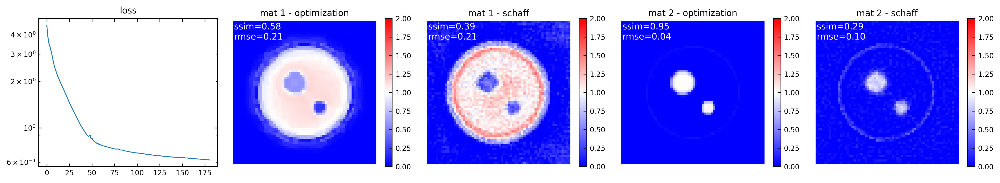

loss @ iter 200: 6.072e-01 (t = 19.7 s)


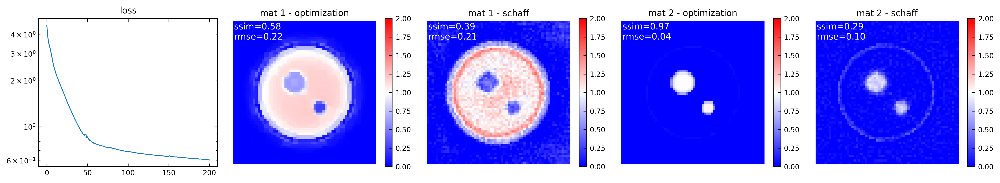

CPU times: user 13.7 s, sys: 495 ms, total: 14.1 s
Wall time: 20.9 s


In [333]:
%%time

truth = data

# # GOOD PARAMS: bone/tissue, 14/24 keV, 64x64, 0.625-mm fov
# LFBGS optimizer
# vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.3, p2=0.17, id2=2, c1=1, c2=1.9)
# max_iter = 100
# LRATE = 0.1
# w_tv = 2e-5
# w_l1 = 2e-5
# ivol = 1e-3

max_iter = 200
EPS = 1e-5
ivol = 1e-3

all_params_ranked = [x for _,x in sorted(zip(all_ssims, all_pars))[::-1]]

# best params from earlier
for pars in [all_params_ranked[0]]:  #all_params_ranked[:2]:
    LRATE, w_tv_mat1, w_tv_mat2, w_l1_mat1, w_l1_mat2 = pars
    print('################################################')
    print('optimizer learning rate:', LRATE)
    print('mat 1 TV weight:', w_tv_mat1)
    print('mat 2 TV weight:', w_tv_mat2)
    print('mat 1 L1 weight:', w_l1_mat1)
    print('mat 2 L1 weight:', w_l1_mat2)    
    
    key = jax.random.PRNGKey(3)
    model = MultiMatPBI()
    params = model.init(key, 0)
    
    params = unfreeze(params)
    params['params']['volume'] = ivol * np.ones(density_phantom.shape, dtype=np.float32)
    params = freeze(params)
    
    forward = jax.vmap(model.apply, in_axes=(None, 0))  
    optimizer = optax.adam(learning_rate=LRATE, eps=EPS)
    opt_state = optimizer.init(params)  
    
    def loss_fn(params, data=truth):
        vol = params['params']['volume']
        vol1, vol2 = vol[:,:,:,0], vol[:,:,:,1]   # separate the material volumes
        y_k = forward(params, thetas)   
        loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv_mat1*TV_3d(vol1) + w_tv_mat2*TV_3d(vol2) + w_l1_mat1*L1(vol1) + w_l1_mat2*L1(vol2)
        return loss
        
    @jax.jit  
    def update(params, opt_state, *args):
        loss, grads = jax.value_and_grad(loss_fn)(params, *args)
        updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
        params = projection_non_negative(optax.apply_updates(params, updates))
        return params, opt_state, loss
        
    show_iter = 20      
    loss = []
    t0 = time()
    for k in range(max_iter+1):
        params, opt_state, loss_k = update(params, opt_state, data)
        loss.append(loss_k)
        if k%show_iter == 0 and k>0:
            print(f'loss @ iter {k}: {loss_k:.3e} (t = {time()-t0:.1f} s)')
            if ~np.isnan(loss_k):
                show_compare(params, loss, density_phantom)



################################################
optimizer learning rate: 0.04
loss @ iter 50: 8.297e-01 (t = 4.2 s)


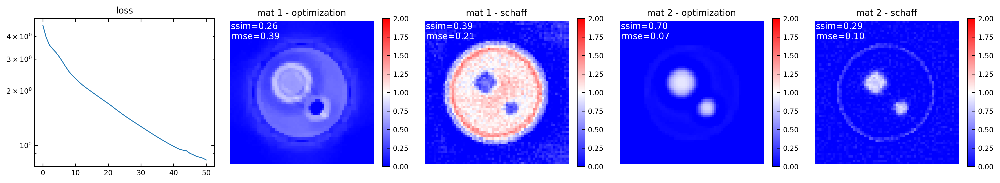

loss @ iter 100: 7.019e-01 (t = 7.2 s)


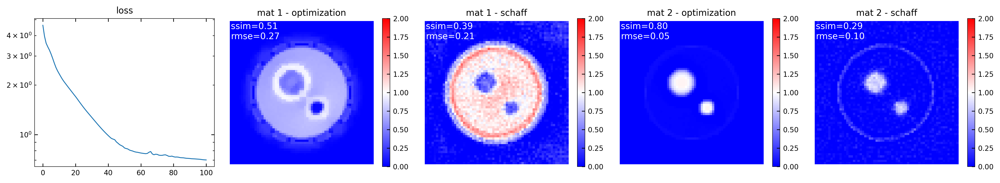

loss @ iter 150: 6.541e-01 (t = 10.2 s)


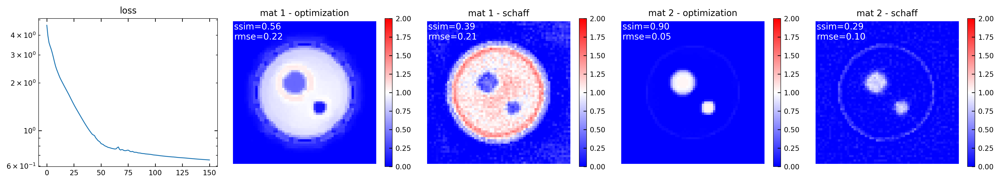

loss @ iter 200: 6.226e-01 (t = 13.2 s)


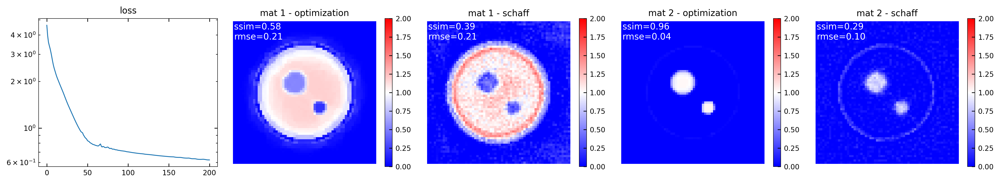

loss @ iter 250: 6.086e-01 (t = 16.2 s)


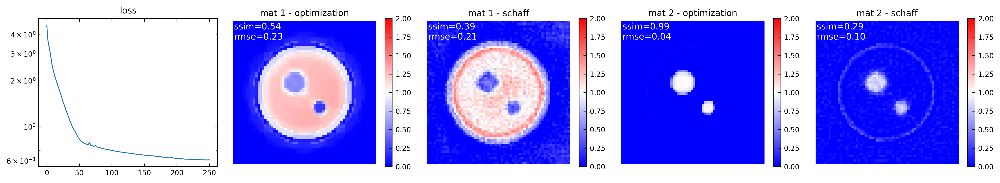

loss @ iter 300: 5.991e-01 (t = 19.1 s)


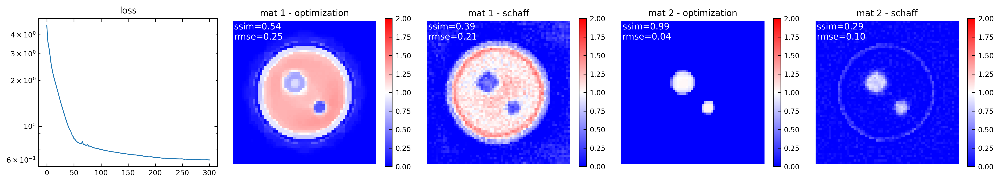

total ssim = 1.530 (t = 20.3 s) [1e-05, 1e-05, 1e-06, 0.0001]
################################################
optimizer learning rate: 0.05
loss @ iter 50: 7.808e-01 (t = 4.3 s)


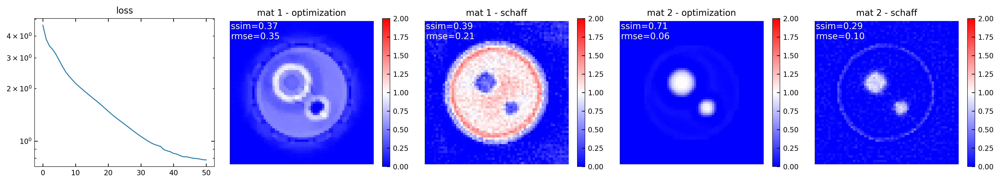

loss @ iter 100: 6.875e-01 (t = 7.3 s)


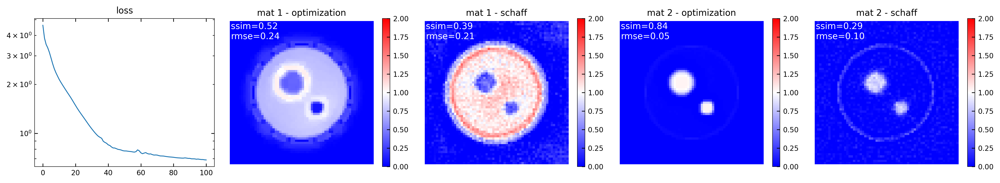

loss @ iter 150: 6.387e-01 (t = 10.2 s)


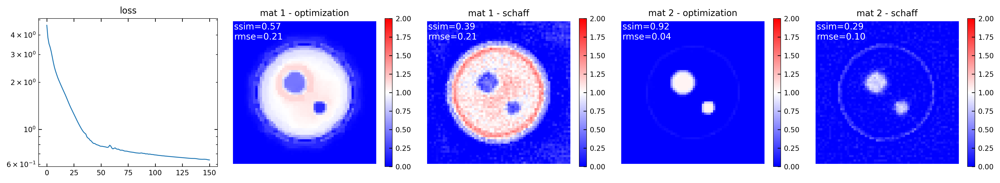

loss @ iter 200: 6.161e-01 (t = 13.2 s)


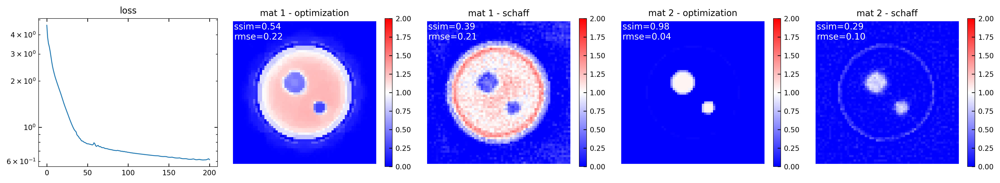

loss @ iter 250: 6.088e-01 (t = 16.2 s)


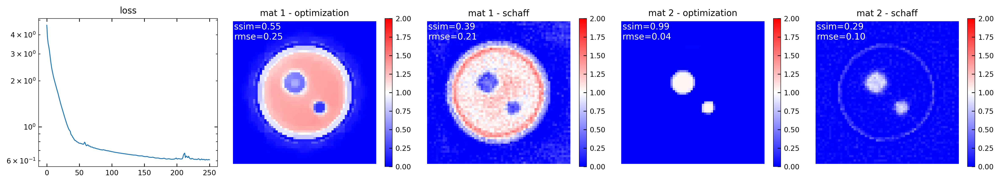

loss @ iter 300: 6.040e-01 (t = 19.2 s)


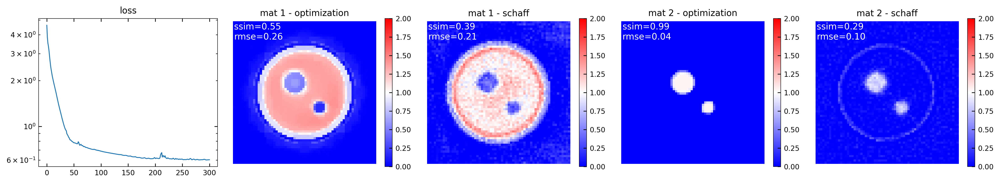

total ssim = 1.536 (t = 20.4 s) [1e-05, 1e-05, 1e-06, 0.0001]
CPU times: user 25.7 s, sys: 3.8 s, total: 29.5 s
Wall time: 40.9 s


In [316]:
%%time

truth = data

# # GOOD PARAMS: bone/tissue, 14/24 keV, 64x64, 0.625-mm fov
# LFBGS optimizer
# vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.3, p2=0.17, id2=2, c1=1, c2=1.9)
# max_iter = 100
# LRATE = 0.1
# w_tv = 2e-5
# w_l1 = 2e-5
# ivol = 1e-3

max_iter = 200
EPS = 1e-5
ivol = 1e-3

best_ssim = 0

for LRATE in [0.04, 0.05]:
    for w_tv_mat1 in [1e-5]:   
        for w_tv_mat2 in [1e-5]:  
            for w_l1_mat1 in [1e-6]:   
                for w_l1_mat2 in [1e-4]:   

                    # print('init vol:', init_vol)
                    print('################################################')
                    print('optimizer learning rate:', LRATE)
                    key = jax.random.PRNGKey(3)
                    model = MultiMatPBI()
                    params = model.init(key, 0)
                    forward = jax.vmap(model.apply, in_axes=(None, 0))  
                    optimizer = optax.adam(learning_rate=LRATE, eps=EPS)
                    opt_state = optimizer.init(params)  
                    
                    def loss_fn(params, data=truth):
                        vol = params['params']['volume']
                        vol1, vol2 = vol[:,:,:,0], vol[:,:,:,1]   # separate the material volumes
                        y_k = forward(params, thetas)   
                        loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv_mat1*TV(vol1) + w_tv_mat2*TV(vol2) + w_l1_mat1*L1(vol1) + w_l1_mat2*L1(vol2)
                        return loss
                        
                    @jax.jit  
                    def update(params, opt_state, *args):
                        loss, grads = jax.value_and_grad(loss_fn)(params, *args)
                        updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
                        params = projection_non_negative(optax.apply_updates(params, updates))
                        return params, opt_state, loss
                    
                    show_iter = 50      
                    loss = []
                    t0 = time()
                    for k in range(max_iter+1):
                        params, opt_state, loss_k = update(params, opt_state, data)
                        loss.append(loss_k)
                        if k%show_iter == 0 and k>0:
                            print(f'loss @ iter {k}: {loss_k:.3e} (t = {time()-t0:.1f} s)')
                            if ~np.isnan(loss_k):
                                show_compare(params, loss, density_phantom)
    
                    metrics = get_metrics(params, density_phantom)
                    these_params = [w_tv_mat1, w_tv_mat2, w_l1_mat1, w_l1_mat2]
                    tot_ssim = metrics[0]['ssim']['opt'] + metrics[1]['ssim']['opt']
                    print(f'total ssim = {tot_ssim:.3f} (t = {time()-t0:.1f} s)', these_params)
                    if (tot_ssim > best_ssim):
                        best_params = these_params
    


In [172]:
%%time

# Init with Schaff?
data_Schaff = np.zeros(data.shape)
for idx in range(N_theta):
    t1, t2 = spbi_material_basis([data[idx,:,:,e]**2 for e in range(2)], distances, px, ds.T, mus.T) 
    data_Schaff[idx,:,:,0] = t1
    data_Schaff[idx,:,:,1] = t2
    
vol_Schaff = np.zeros(density_phantom.shape)
for z_level in range(density_phantom.shape[1]):
    vol_Schaff[::-1,z_level,::-1,0] = model.material_basis[1].density * get_recon(data_Schaff[:,z_level,:,0], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
    vol_Schaff[::-1,z_level,::-1,1] = model.material_basis[2].density * get_recon(data_Schaff[:,z_level,:,1], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])

CPU times: user 1min 28s, sys: 18.3 s, total: 1min 47s
Wall time: 1min 4s


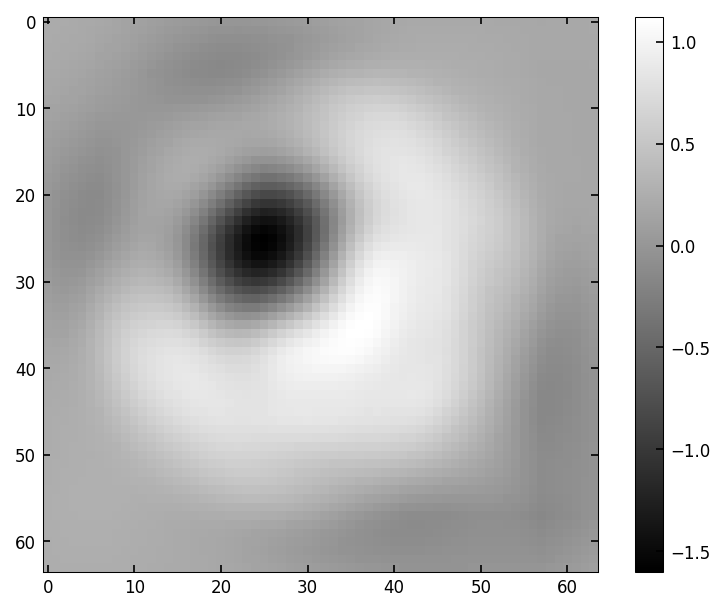

CPU times: user 403 ms, sys: 22.6 ms, total: 425 ms
Wall time: 427 ms


In [10]:
%%time

vol_Schaff_blur = np.zeros(density_phantom.shape)
for z_level in range(density_phantom.shape[1]):
    for e in range(2):
        vol_Schaff_blur[:,z_level,:,e] = apply_psf(vol_Schaff[:,z_level,:,e], model.det_fov, model.det_dx, psf=model.det_psf, fwhm=model.det_fov*0.5, kernel_width=0.1)

plt.imshow(vol_Schaff_blur[:,3,:,0])
plt.colorbar()
plt.show()

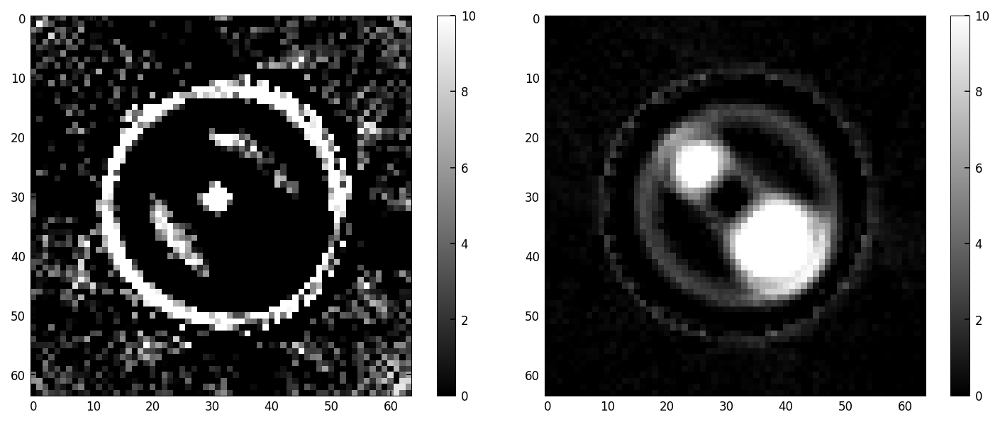

CPU times: user 18.5 s, sys: 1.86 s, total: 20.4 s
Wall time: 14.4 s


In [12]:
%%time

# Init with A&M?
recon_data = np.zeros(density_phantom.shape)
for z_level in range(density_phantom.shape[1]):
    sino = -np.log(data[:,z_level,:,:]**2)
    recon_data[:,z_level,:,0] = get_recon(sino[:,:,0], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])
    recon_data[:,z_level,:,1] = get_recon(sino[:,:,1], N_matrix=Nv, FOV=model.det_fov, s=model.det_dx, dbeta=jnp.diff(thetas)[0])

d1 = model.material_basis[1].density
d2 = model.material_basis[2].density
iMAC = np.linalg.inv(mus.T / np.array([[d1, d1], [d2, d2]]))

recon_AM = np.zeros(density_phantom.shape)
for x in range(density_phantom.shape[0]):  # bad for loops!
    for y in range(density_phantom.shape[2]):
        for z in range(density_phantom.shape[1]):
            recon_AM[x,z,y] = np.linalg.matmul(iMAC, recon_data[x,z,y])
            
fig, ax = plt.subplots(1,2,figsize=[10,4])
for i in range(2):
    m = ax[i].imshow(recon_AM[:,3,:,i].clip(0,10))
    fig.colorbar(m, ax=ax[i])
fig.tight_layout()
plt.show()



#########################################
learning rate: 0.1
TV weight: 0
L1 weight: 0
loss @ iter 100: 1.567e-01 (t = 5.0 s)


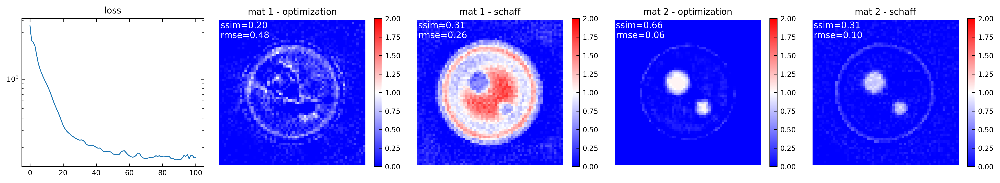

#########################################
learning rate: 0.1
TV weight: 2e-05
L1 weight: 0
loss @ iter 100: 2.635e-01 (t = 5.1 s)


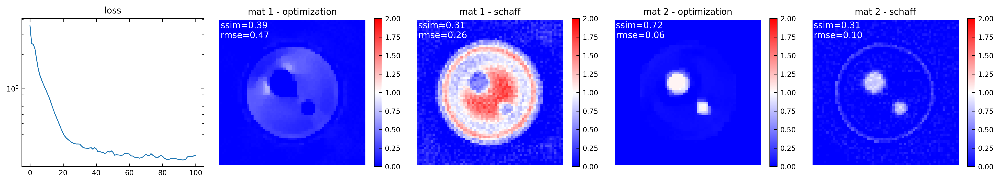

#########################################
learning rate: 0.1
TV weight: 0.0002
L1 weight: 0
loss @ iter 100: 7.226e-01 (t = 5.0 s)


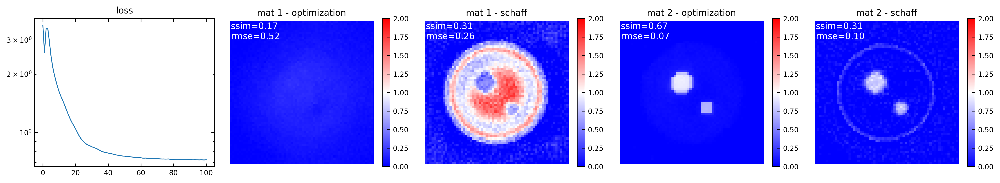

#########################################
learning rate: 0.1
TV weight: 0
L1 weight: 2e-05
loss @ iter 100: 2.489e-01 (t = 5.0 s)


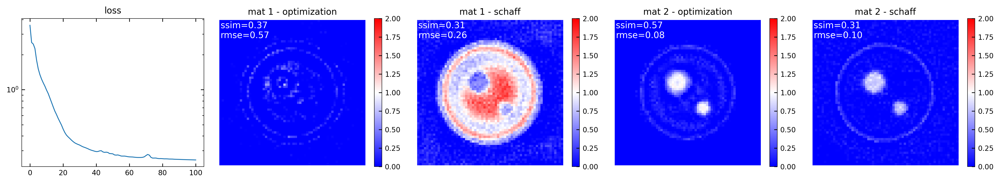

#########################################
learning rate: 0.1
TV weight: 2e-05
L1 weight: 2e-05
loss @ iter 100: 3.087e-01 (t = 5.0 s)


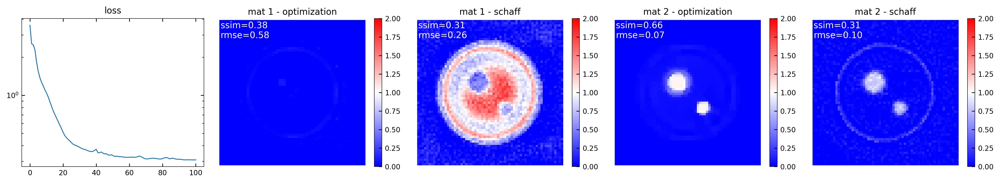

#########################################
learning rate: 0.1
TV weight: 0.0002
L1 weight: 2e-05
loss @ iter 100: 6.953e-01 (t = 5.0 s)


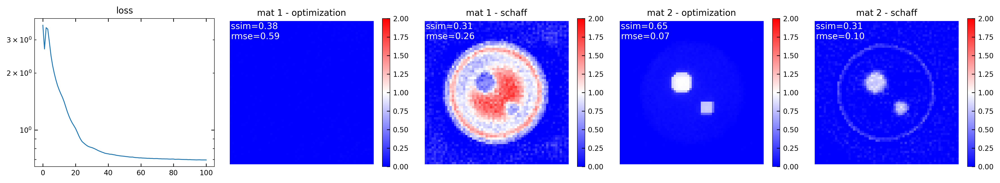

#########################################
learning rate: 0.1
TV weight: 0
L1 weight: 0.0002
loss @ iter 100: 8.977e-01 (t = 4.9 s)


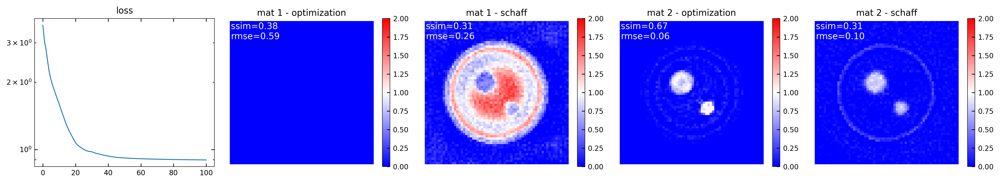

#########################################
learning rate: 0.1
TV weight: 2e-05
L1 weight: 0.0002
loss @ iter 100: 9.467e-01 (t = 5.0 s)


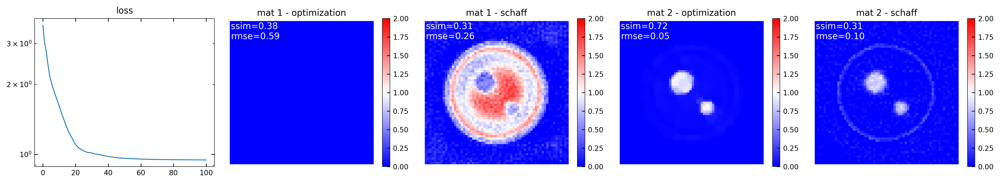

#########################################
learning rate: 0.1
TV weight: 0.0002
L1 weight: 0.0002
loss @ iter 100: 1.162e+00 (t = 5.0 s)


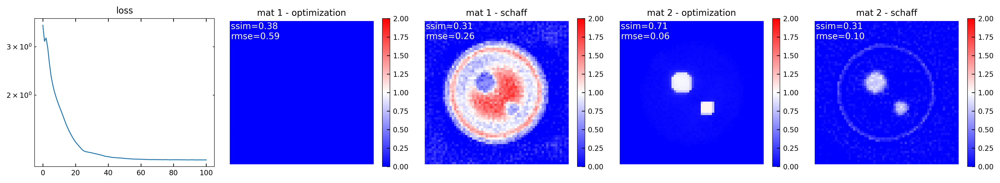

CPU times: user 43.5 s, sys: 5.9 s, total: 49.4 s
Wall time: 55.5 s


In [261]:
%%time

truth = data

# # GOOD PARAMS: bone/tissue, 14/24 keV, 64x64, 0.625-mm fov
# LFBGS optimizer
# vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.3, p2=0.17, id2=2, c1=1, c2=1.9)
# max_iter = 100
# LRATE = 0.1
# w_tv = 2e-5
# w_l1 = 2e-5
# ivol = 1e-3

max_iter = 100
LRATE = 0.1
w_tv = 2e-5
w_l1 = 2e-5
ivol = 1e-3


for w_l1 in [0, 2e-5, 2e-4]:
    for w_tv in [0, 2e-5, 2e-4]:
        print('#########################################')
        # print('init vol:', init_vol)
        print('learning rate:', LRATE)
        print('TV weight:', w_tv)
        print('L1 weight:', w_l1)
            
        # recreate the forward model *without* simulated data
        key = jax.random.PRNGKey(3)
        model = MultiMatPBI()
        params = model.init(key, 0)
        
        params = unfreeze(params)
        # params['params']['volume'] = np.array(vol_Schaff, dtype=np.float32)
        params['params']['volume'] = ivol * np.ones(density_phantom.shape, dtype=np.float32)
        params = freeze(params)
        
        forward = jax.vmap(model.apply, in_axes=(None, 0))  
        # optimizer = optax.lbfgs(learning_rate=LRATE)
        optimizer = optax.adam(learning_rate=LRATE, eps=1e-5)
        opt_state = optimizer.init(params)  
        
        def loss_fn(params, data=truth):
            vol = params['params']['volume']
            y_k = forward(params, thetas)   
            loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv*TV(vol, yax=2) + w_l1*L1(vol)
            # loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + phiTV(vol, w_tv, yax=2) + w_l1*L1(vol)
            return loss
            
        @jax.jit  
        def update(params, opt_state, *args):
            loss, grads = jax.value_and_grad(loss_fn)(params, *args)
            updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
            params = projection_non_negative(optax.apply_updates(params, updates))
            return params, opt_state, loss
        
        show_iter = max_iter      
        loss = []
        t0 = time()
        for k in range(max_iter+1):
            params, opt_state, loss_k = update(params, opt_state, data)
            loss.append(loss_k)
            if k%show_iter == 0 and k>0:
                print(f'loss @ iter {k}: {loss_k:.3e} (t = {time()-t0:.1f} s)')
                if ~np.isnan(loss_k):
                    show_compare(params, loss, density_phantom)
        
        
        metrics = get_metrics(params, density_phantom)



-0.0001


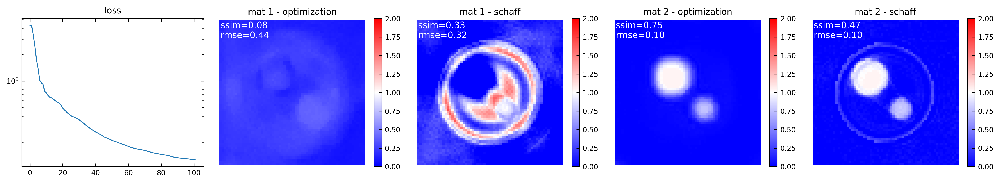

0


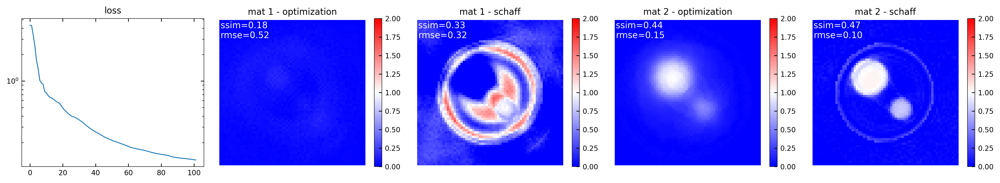

2e-05


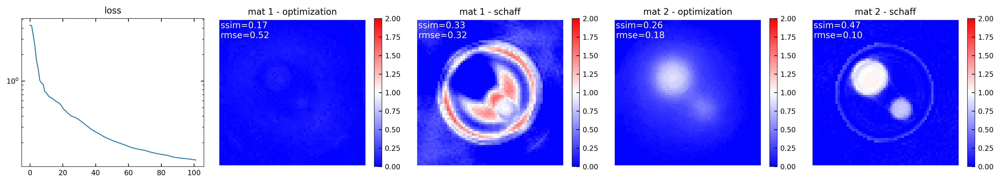

In [138]:
LRATE = 0.1
w_tv = 0.0002

for w_l1 in [-0.0001, 0, 0.00002]:
    print(w_l1)

    key = jax.random.PRNGKey(3)
    model = MultiMatPBI()
    params = model.init(key, 0)
    forward = jax.vmap(model.apply, in_axes=(None, 0))  
    optimizer = optax.lbfgs(learning_rate=LRATE)
    opt_state = optimizer.init(params)  
    
    def loss_fn(params, data=truth):
        vol = params['params']['volume']
        y_k = forward(params, thetas)   
        loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv*TV(vol, yax=2) + w_l1*L1(vol)
        return loss
        
    @jax.jit  
    def update(params, opt_state, *args):
        loss, grads = jax.value_and_grad(loss_fn)(params, *args)
        updates, opt_state = optimizer.update(grads, opt_state, params,value=loss, grad=grads, value_fn=loss_fn)
        params = projection_non_negative(optax.apply_updates(params, updates))
        return params, opt_state, loss
    
    for k in range(50):
        params, opt_state, loss_k = update(params, opt_state, data)
    
    show_compare(params, loss, density_phantom)


In [91]:
%%time

class MultiMatPBI(nn.Module):

    # Simulation settings
    propdist = 0
    energies = jnp.array([24, 34])  
    material_basis = {1: water, 2: alu} 
             
    # Phantom
    phantom_Nx: int = 64
    phantom_Ny: int = 64
    phantom_dx: float = 5e-6
    
    # Detector
    det_Nx: int = 64
    det_Ny: int = 64
    det_fwhm: float = 5e-6
    det_psf: str = 'lorentzian'  # code for the PSF is in fun.py
    resampling_method: str = 'linear'
    I0: int = 1e7  # should normalize this to pixel size later

    # Misc.
    ds1, bs1 = material_basis[1].delta_beta(energies)
    ds2, bs2 = material_basis[2].delta_beta(energies)
    n1 = (ds1 + 1j*bs1) / material_basis[1].density  # normalized to the default density!!
    n2 = (ds2 + 1j*bs2) / material_basis[2].density
    phantom_fov: float = phantom_Nx*phantom_dx
    det_fov: float = 0.95*phantom_fov
    det_dx: float = det_fov / det_N
    wavelens = get_wavelen(energies)
    N_pad: int = 100
    n_medium: float = 1  
    key = jax.random.PRNGKey(3)
    
    def setup(self):
        
        # initialize empty volume (last axis used for basis material, voxels represent density)
        self.volume = self.param(
            'volume',
            lambda key, shape: jnp.full(shape, 1e-3, dtype=jnp.float32),
            (self.phantom_Nx, self.phantom_Ny, self.phantom_Nx, len(self.material_basis)),
        )

        # function to resample source field to detectory geometry
        self.det_resample_func = init_plane_resample(
            (self.det_N, self.det_N), 
            (self.det_dx, self.det_dx), 
            resampling_method=self.resampling_method
        )

    
    def __call__(self, angle: float) -> Array:

        # non-negative
        # self.volume.clip(0, None)
        
        # convert the density phantom to beta, delta at the beam energies
        # vol_beta, vol_dn = density_to_db_phantom(self.volume, self.material_basis, self.energies)
        Nx, Ny, Nz = self.phantom_Nx, self.phantom_Ny, self.phantom_Nx
        vol_db_mat1 = jnp.tile(self.n1, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
        vol_db_mat2 = jnp.tile(self.n2, [Nx, Ny, Nz]).reshape([Nx, Ny, Nz, 2]) 
        
        volume = vol_db_mat1 * jnp.stack([self.volume[:,:,:,0], self.volume[:,:,:,0]], axis=-1) + vol_db_mat2 * jnp.stack([self.volume[:,:,:,1], self.volume[:,:,:,1]], axis=-1)
        volume = jnp.stack([volume.imag, volume.real], axis=0)
         # volume = jnp.stack([vol_beta, vol_dn], axis=0)
        
        # incident wave
        field = cx.plane_wave(
            shape = (self.phantom_Nx, self.phantom_Ny),
            dx = self.phantom_dx,
            spectrum = self.wavelens,
            spectral_density = jnp.ones(self.wavelens.size)
        ) 
        field = field / field.intensity.max()**0.5 / (self.phantom_Nx / self.det_N)**2  # normalize
        cval = field.intensity.max()

        # thru object
        rotated_vol = jax.vmap(
            rotate_volume_4d,
            in_axes=(0, None)
        )(volume, angle)
        
        vol_proj = jnp.sum(rotated_vol, axis=3)
        beta_proj = vol_proj[0, None, ..., None]
        dn_proj = vol_proj[1, None, ..., None]
        
        exit_field = cx.thin_sample(field, beta_proj, dn_proj, self.phantom_dx)

        # to detector
        det_field = cx.transfer_propagate(exit_field, self.propdist, self.n_medium, self.N_pad, cval=cval, mode='same')
        imgs = self.det_resample_func(det_field.amplitude.squeeze()[..., None], field.dx.ravel()[:1])[...,0]

        # # detector nonidealities
        # imgs = jax.random.poisson(self.key, self.I0*imgs, imgs.shape) / self.I0  # noise
        imgs = jax.vmap(
            lambda img: apply_psf(img, self.det_fov, self.det_dx, psf=self.det_psf, fwhm=self.det_fwhm, kernel_width=0.1),
            in_axes = -1,
            out_axes = -1
        )(imgs)
        
        return imgs
        

################################################################
################################################################


tot_theta = PI  
N_theta = 101
thetas = jnp.linspace(0, tot_theta*(1-1/N_theta), N_theta)

# Set up model
key = jax.random.PRNGKey(3)
model = MultiMatPBI()
params = model.init(key, 0)

# Replace volume with a real phantom for simulating data
# Create a 2-material raw volume.
Nx, Ny = model.phantom_Nx, model.phantom_Ny
vol_raw = make_raw_phantom(Nx, p0=0.7, p1=0.3, p2=0.17, id2=2, c1=1, c2=1.9)
for i, item in enumerate(model.material_basis.items()):
    key, mat = item
    density_phantom[:,:,:,i][vol_raw==key] = mat.density
# subvol_raw = vol_raw[:,(Nx-Ny)//2:(Nx+Ny)//2,:]
# density_phantom = np.zeros([Nx, Ny, Nx, len(model.material_basis)])
# for i, item in enumerate(model.material_basis.items()):
#     idx, mat = item
#     density_phantom[:,:,:,i][subvol_raw==idx] = mat.density       

params = unfreeze(params)
params['params']['volume'] = jnp.array(density_phantom)
params = freeze(params)

# Simulate
forward = jax.jit(jax.vmap(model.apply, in_axes=(None, 0)))
data = forward(params, thetas)

# Add noise to the real data
key = jax.random.PRNGKey(3)
data = jax.random.poisson(key, model.I0*data, data.shape) / model.I0   # noise

# # Show data
# fig, ax = plt.subplots(2, 3, figsize=[9,5.2], dpi=300)
# for i in range(2):  # 2 energies
#     for jj,j in enumerate([0, N_theta//8, N_theta//4]):
#         axi = ax[i,jj]
#         m = axi.imshow(data[j,:,:,i], vmin=data.min(), vmax=data.max())
#         axi.set_xticks([])
#         axi.set_yticks([])
#         ax[0,jj].set_title(f'{180/np.pi * thetas[j]:.0f} deg')
#     ax[i,0].set_ylabel(f'{model.energies[i]:.0f} keV')
#     fig.colorbar(m, ax=axi)
# fig.tight_layout()
# plt.show()

CPU times: user 1.69 s, sys: 139 ms, total: 1.82 s
Wall time: 1.82 s


iter 10 - 2.081e+00 (t = 4.8 s)


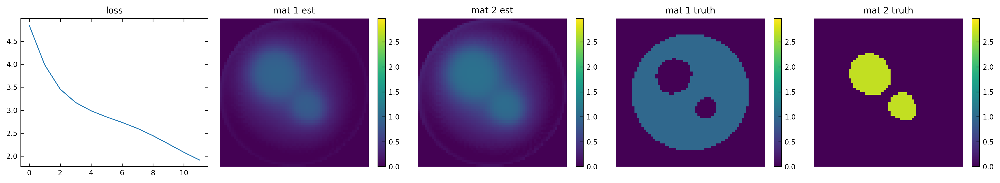

CPU times: user 4.31 s, sys: 176 ms, total: 4.48 s
Wall time: 5.98 s


In [92]:
%%time

w_l1 = 0
w_tv = 0
LRATE = 0.1

# recreate the forward model *without* simulated data
key = jax.random.PRNGKey(3)
model = MultiMatPBI()
params = model.init(key, 0)
forward = jax.vmap(model.apply, in_axes=(None, 0))  

# optimizer
# optimizer = optax.lbfgs(learning_rate=LRATE)#, eps=EPS)   # lr=0.01, 0.001 look worse. eps=1e-5 looks worse
optimizer = optax.adam(learning_rate=LRATE, eps=1e-5)   # lr=0.01, 0.001 look worse. eps=1e-5 looks worse
opt_state = optimizer.init(params)  

def loss_fn(params, data):
    y_k = forward(params, thetas)   
    loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv*TV(y_k) + w_l1*L1(y_k)
    return loss

def val_fn(params):
    y_k = forward(params, thetas)   
    loss = jnp.sqrt(jnp.sum((y_k - data)**2)) + w_tv*TV(y_k) + w_l1*L1(y_k)
    return loss
    
@jax.jit  
def update(params, opt_state, *args):
    loss = loss_fn(params, *args)
    grads = jax.grad(loss_fn, argnums=0)(params, *args)
    updates, opt_state = optimizer.update(grads, opt_state, params,
                                         # value=loss, grad=grads, value_fn=val_fn
                                         )
    params = projection_non_negative(optax.apply_updates(params, updates))
    metrics = {'loss': loss}
    return params, opt_state, metrics

max_iter = 11  #int(10/LRATE) 
show_iter = 10 #100 #100 
loss = []
t0 = time()
for k in range(max_iter+1):
    params, opt_state, metrics = update(params, opt_state, data)
    loss.append(metrics['loss'])
    if k%show_iter == 0 and k>0:
        print(f'iter {k} - {metrics["loss"]:.3e} (t = {time()-t0:.1f} s)')
see_opt(params['params']['volume'], density_phantom, loss)
